# Precipitation Response: Agung vs. Sata Maria
* Wenchang Yang (wenchang@prnceton.edu)
* Department of Geosciences, Princeton University

In [138]:
import sys, os, os.path, datetime, glob
import numpy as np, matplotlib.pyplot as plt, pandas as pd, xarray as xr

from geoplots.cartopy.api import cartoplot
from geoplots import yticks2lat
from myplot import figcolorbar
from misc.image import make_gif

import warnings
warnings.filterwarnings('ignore')

%matplotlib notebook

In [6]:
# params

In [37]:
data_name = 'extsw_b07'
ncfile = '/tigress/gvecchi/CM2.5/input/VOLCANIC/CMIP6/extsw_V3_DATATROP_RCP.nc'
ds = xr.open_dataset(ncfile)
da = ds[data_name].mean('lon').sum('pfull')
extsw = da

In [143]:
# data
if 'das' in globals() or 'das' in locals():
    pass
else:
    das = dict()
    
datanames = ['t_surf', 'precip']
volcs = ['Agung', 'StMaria']

for dataname in datanames:
    # volc
    ifiles = [f'data/{volc}_PI_ens_noleap.atmos_month.{dataname}.nc'
             for volc in volcs]
    for volc, ifile in zip(volcs, ifiles):
        key = f'{dataname}_{volc}'
        print(key, end='; ')
        da = xr.open_dataarray(ifile)
        das[key] = da.load()

    # # volc_nudge
    # ifiles = [f'data/{volc}_ens_noleap_nudgeclimo_all_model1860.atmos_month.{dataname}.nc'
    #          for volc in volcs]
    # for volc, ifile, yyyy, mm in zip(volcs, ifiles, years, months):
    #     key = f'{volc}_nudge_{dataname}'
    #     print(key)
    #     tspan = slice(f'{yyyy+1}-{mm:02d}', f'{yyyy+1+n_years}-{mm-1:02d}')
    #     da = xr.open_dataarray(ifile).sel(time=tspan).mean('time')
    #     das[key] = da

    # ctl
    ifile = f'data/CTL1860_noleap_tigercpu_intelmpi_18_576PE.atmos_month.{dataname}.nc'
    for volc in volcs:
        key = f'{dataname}_{volc}_ctl'
        print(key, end='; ')
        da = xr.open_dataarray(ifile).assign_coords(time=das[f'{dataname}_{volc}'].time)
        das[key] = da.load()

    # # ctl_nudge
    # ifile = f'data/nudgeclimo_all_model_CTL1860_tigercpu_intelmpi_18_576PE.atmos_month.{dataname}.nc'
    # for volc, yyyy, mm in zip(volcs, years, months):
    #     key = f'{volc}_nudge_ctl_{dataname}'
    #     print(key)
    #     tspan = slice(mm-1+12, mm-1+12+n_years*12)
    #     da = xr.open_dataarray(ifile).isel(time=tspan).mean('time')
    #     das[key] = da

t_surf_Agung; t_surf_StMaria; t_surf_Agung_ctl; t_surf_StMaria_ctl; precip_Agung; precip_StMaria; precip_Agung_ctl; precip_StMaria_ctl; 

<IPython.core.display.Javascript object>


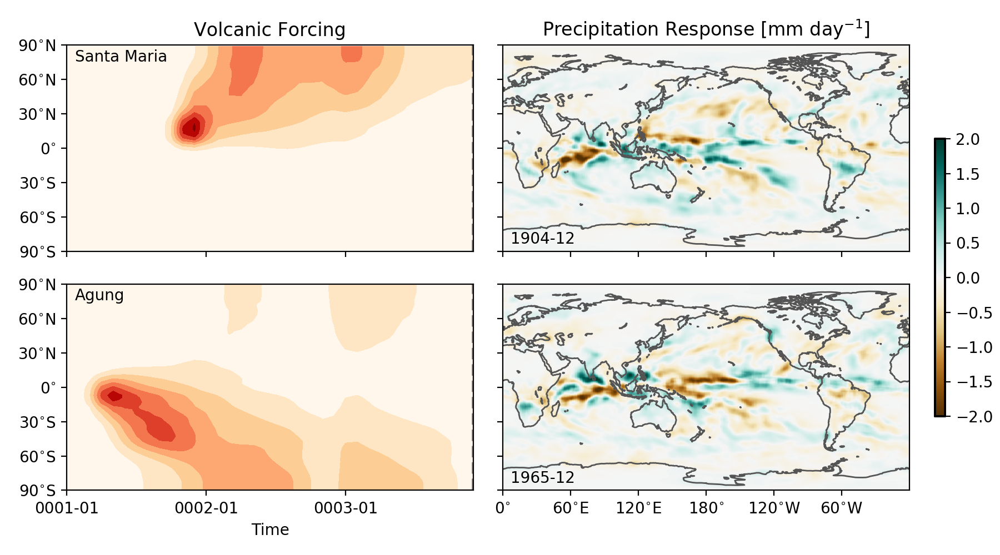

month 01; month 02; month 03; month 04; month 05; month 06; month 07; month 08; month 09; month 10; month 11; month 12; month 13; month 14; month 15; month 16; month 17; month 18; month 19; month 20; month 21; month 22; month 23; month 24; month 25; month 26; month 27; month 28; month 29; month 30; month 31; month 32; month 33; month 34; month 35; month 36; [OK]: convert -delay 100 -loop 0 img/frames/precip_01.png img/frames/precip_02.png img/frames/precip_03.png img/frames/precip_04.png img/frames/precip_05.png img/frames/precip_06.png img/frames/precip_07.png img/frames/precip_08.png img/frames/precip_09.png img/frames/precip_10.png img/frames/precip_11.png img/frames/precip_12.png img/frames/precip_13.png img/frames/precip_14.png img/frames/precip_15.png img/frames/precip_16.png img/frames/precip_17.png img/frames/precip_18.png img/frames/precip_19.png img/frames/precip_20.png img/frames/precip_21.png img/frames/precip_22.png img/frames/precip_23.png img/frames/precip_24.png img/fra

In [141]:
# plot precip
months = np.arange(1, 37)
fig, axes = plt.subplots(2, 2, sharex='col', sharey='row', figsize=(9,5))
scale_factor = 1e5
for imonth in months:
    for ax in axes.flat:
        ax.clear()
        
    yearA = 1963 + (imonth-1)//12
    monA = imonth - (imonth-1)//12*12
    yearS = 1902 + (imonth-1)//12
    monS = imonth - (imonth-1)//12*12
    print('month', f'{imonth:02d}', end='; ')

    ax = axes[0, 0]
    plt.sca(ax)
    extsw.pipe(lambda x: x*scale_factor).sel(time=slice('1902','1904')) \
        .assign_coords(time=months) \
        .plot.contourf(x='time', 
                       cmap='OrRd', 
                       levels=np.arange(0,16.1,2),
                       add_colorbar=False, ax=ax)
    ax.axvline(imonth, color='gray', ls='--')
    ax.set_xlabel('')
    ax.set_ylabel('')
    yticks2lat(np.arange(-90, 91, 30))
    ax.text(0.02, 0.98, f'Santa Maria',
            ha='left', va='top', transform=ax.transAxes)
    ax.set_title('Volcanic Forcing')


    ax = axes[1, 0]
    plt.sca(ax)
    extsw.pipe(lambda x: x*scale_factor).sel(time=slice('1963','1965')) \
        .assign_coords(time=months) \
        .plot.contourf(x='time', 
                       cmap='OrRd', 
                       levels=np.arange(0,16.1,2),
                       add_colorbar=False, ax=ax)
    ax.axvline(imonth, color='gray', ls='--')
    ax.set_xticks(np.arange(1, 37, 12))
    ax.set_xticklabels(['0001-01', '0002-01', '0003-01'])
    ax.set_xlabel('Time')
    ax.set_ylabel('')
    yticks2lat(np.arange(-90, 91, 30))
    ax.text(0.02, 0.98, f'Agung', 
            ha='left', va='top', transform=ax.transAxes)



    ax = axes[0, 1]
    plt.sca(ax)
    ( das['precip_StMaria'] - das['precip_StMaria_ctl'] ) \
        .sel(time=f'{yearS}-{monS}').mean(['en', 'time']) \
        .pipe(lambda x: x*24*3600) \
        .pipe(lambda x: x.rolling(lon=9, center=True, min_periods=1)).mean() \
        .pipe(lambda x: x.rolling(lat=9, center=True, min_periods=1)).mean() \
        .plot(cmap='BrBG', ax=ax, add_colorbar=False, vmin=-2, vmax=2)
    #     .geo.plot(proj='robin', cmap='BrBG', lon_0=200, ax=ax)
    plt.sca(ax)
    mapplot()
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title('Precipitation Response [mm day$^{-1}$]')
    ax.text(0.02, 0.02, f'{yearS}-{monS:02d}', 
            ha='left', va='bottom', transform=ax.transAxes)


    ax = axes[1, 1]
    im = ( das['precip_Agung'] - das['precip_Agung_ctl'] ) \
        .sel(time=f'{yearA}-{monA}').mean(['en', 'time']) \
        .pipe(lambda x: x*24*3600) \
        .pipe(lambda x: x.rolling(lon=9, center=True, min_periods=1)).mean() \
        .pipe(lambda x: x.rolling(lat=9, center=True, min_periods=1)).mean() \
        .plot(cmap='BrBG', ax=ax, add_colorbar=False, vmin=-2, vmax=2)
    #     .geo.plot(proj='robin', cmap='BrBG', lon_0=200, ax=ax)
    plt.sca(ax)
    mapplot()
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.text(0.02, 0.02, f'{yearA}-{monA:02d}', 
            ha='left', va='bottom', transform=ax.transAxes)

    figcolorbar(im, center=(0.94, 0.5))

    plt.tight_layout(rect=[0,0,0.93,1])
    
    plt.savefig(f'img/frames/precip_{imonth:02d}.png')
    
    
print()
make_gif(ifile='img/frames/precip_??.png', ofile='img/volc_impact_on_prcp.gif', delay=100)

<IPython.core.display.Javascript object>


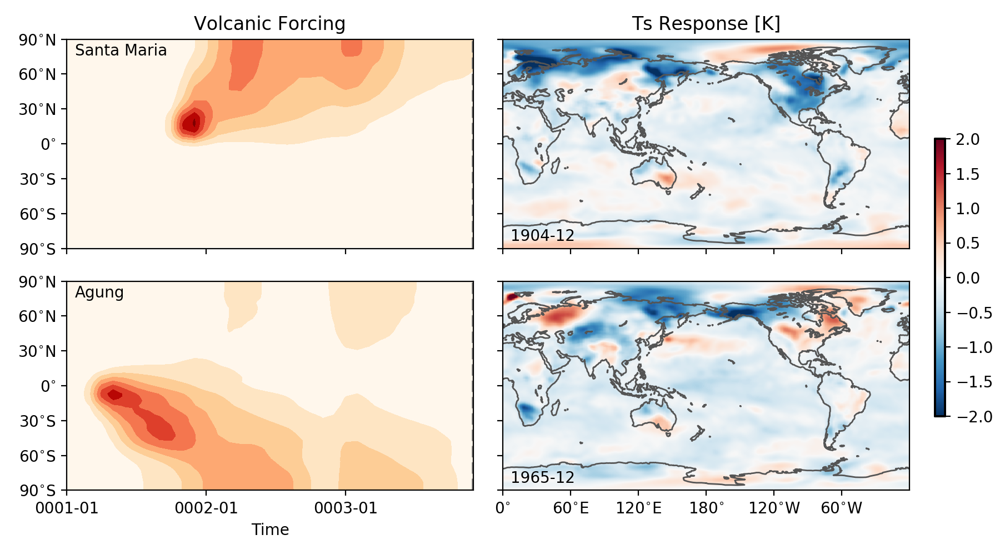

month 01; month 02; month 03; month 04; month 05; month 06; month 07; month 08; month 09; month 10; month 11; month 12; month 13; month 14; month 15; month 16; month 17; month 18; month 19; month 20; month 21; month 22; month 23; month 24; month 25; month 26; month 27; month 28; month 29; month 30; month 31; month 32; month 33; month 34; month 35; month 36; 
[OK]: convert -delay 100 -loop 0 img/frames/ts_01.png img/frames/ts_02.png img/frames/ts_03.png img/frames/ts_04.png img/frames/ts_05.png img/frames/ts_06.png img/frames/ts_07.png img/frames/ts_08.png img/frames/ts_09.png img/frames/ts_10.png img/frames/ts_11.png img/frames/ts_12.png img/frames/ts_13.png img/frames/ts_14.png img/frames/ts_15.png img/frames/ts_16.png img/frames/ts_17.png img/frames/ts_18.png img/frames/ts_19.png img/frames/ts_20.png img/frames/ts_21.png img/frames/ts_22.png img/frames/ts_23.png img/frames/ts_24.png img/frames/ts_25.png img/frames/ts_26.png img/frames/ts_27.png img/frames/ts_28.png img/frames/ts_29.p

In [142]:
# plot
months = np.arange(1, 37)
fig, axes = plt.subplots(2, 2, sharex='col', sharey='row', figsize=(9,5))
scale_factor = 1e5

for imonth in months:
#     plt.close('all')
    for ax in axes.flat:
        ax.clear()
        
    yearA = 1963 + (imonth-1)//12
    monA = imonth - (imonth-1)//12*12
    yearS = 1902 + (imonth-1)//12
    monS = imonth - (imonth-1)//12*12
    print('month', f'{imonth:02d}', end='; ')

    ax = axes[0, 0]
    plt.sca(ax)
    extsw.pipe(lambda x: x*scale_factor).sel(time=slice('1902','1904')) \
        .assign_coords(time=months) \
        .plot.contourf(x='time', 
                       cmap='OrRd', 
                       levels=np.arange(0,16.1,2),
                       add_colorbar=False, ax=ax)
    ax.axvline(imonth, color='gray', ls='--')
    ax.set_xlabel('')
    ax.set_ylabel('')
    yticks2lat(np.arange(-90, 91, 30))
    ax.text(0.02, 0.98, f'Santa Maria',
            ha='left', va='top', transform=ax.transAxes)
    ax.set_title('Volcanic Forcing')


    ax = axes[1, 0]
    plt.sca(ax)
    extsw.pipe(lambda x: x*scale_factor).sel(time=slice('1963','1965')) \
        .assign_coords(time=months) \
        .plot.contourf(x='time', 
                       cmap='OrRd', 
                       levels=np.arange(0,16.1,2),
                       add_colorbar=False, ax=ax)
    ax.axvline(imonth, color='gray', ls='--')
    ax.set_xticks(np.arange(1, 37, 12))
    ax.set_xticklabels(['0001-01', '0002-01', '0003-01'])
    ax.set_xlabel('Time')
    ax.set_ylabel('')
    yticks2lat(np.arange(-90, 91, 30))
    ax.text(0.02, 0.98, f'Agung', 
            ha='left', va='top', transform=ax.transAxes)



    ax = axes[0, 1]
    plt.sca(ax)
    ( das['t_surf_StMaria'] - das['t_surf_StMaria_ctl'] ) \
        .sel(time=f'{yearS}-{monS}').mean(['en', 'time']) \
        .pipe(lambda x: x.rolling(lon=9, center=True, min_periods=1)).mean() \
        .pipe(lambda x: x.rolling(lat=9, center=True, min_periods=1)).mean() \
        .plot(cmap='RdBu_r', ax=ax, add_colorbar=False, vmin=-2, vmax=2)
    #     .geo.plot(proj='robin', cmap='BrBG', lon_0=200, ax=ax)
    plt.sca(ax)
    mapplot()
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title('Ts Response [K]')
    ax.text(0.02, 0.02, f'{yearS}-{monS:02d}', 
            ha='left', va='bottom', transform=ax.transAxes)


    ax = axes[1, 1]
    im = ( das['t_surf_Agung'] - das['t_surf_Agung_ctl'] ) \
        .sel(time=f'{yearA}-{monA}').mean(['en', 'time']) \
        .pipe(lambda x: x.rolling(lon=9, center=True, min_periods=1)).mean() \
        .pipe(lambda x: x.rolling(lat=9, center=True, min_periods=1)).mean() \
        .plot(cmap='RdBu_r', ax=ax, add_colorbar=False, vmin=-2, vmax=2)
    #     .geo.plot(proj='robin', cmap='BrBG', lon_0=200, ax=ax)
    plt.sca(ax)
    mapplot()
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.text(0.02, 0.02, f'{yearA}-{monA:02d}', 
            ha='left', va='bottom', transform=ax.transAxes)

    figcolorbar(im, center=(0.94, 0.5))

    plt.tight_layout(rect=[0,0,0.93,1])
    
    plt.savefig(f'img/frames/ts_{imonth:02d}.png')

print()
make_gif(ifile='img/frames/ts_??.png', ofile='img/volc_impact_on_Ts.gif', delay=100)

<IPython.core.display.Javascript object>


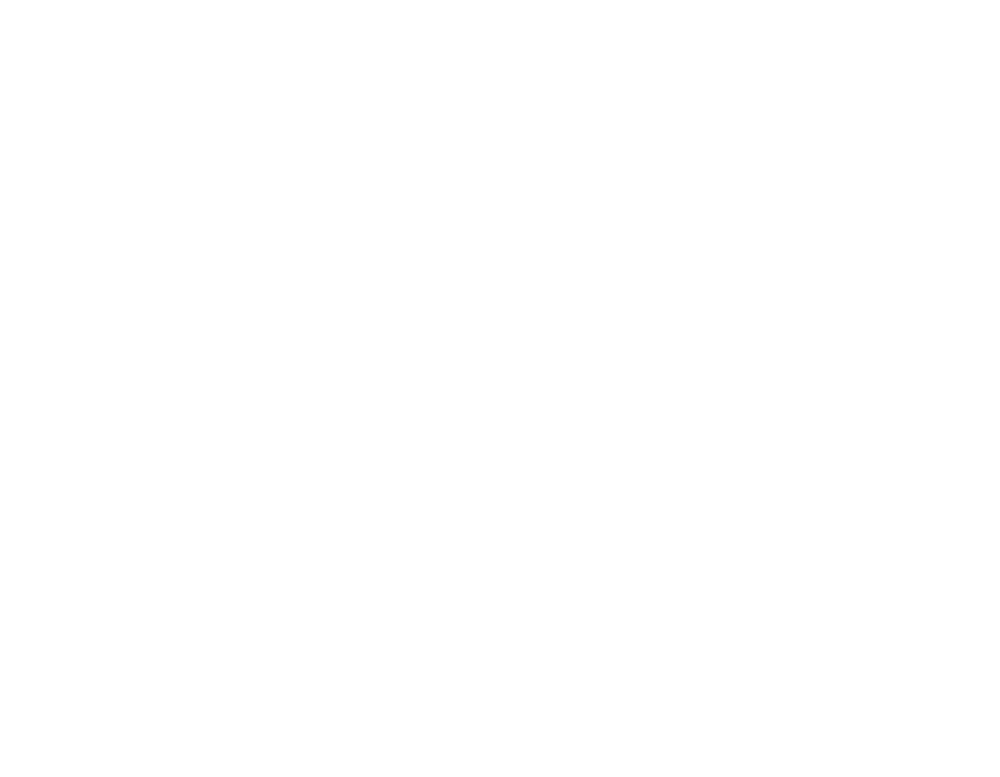

month 01; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


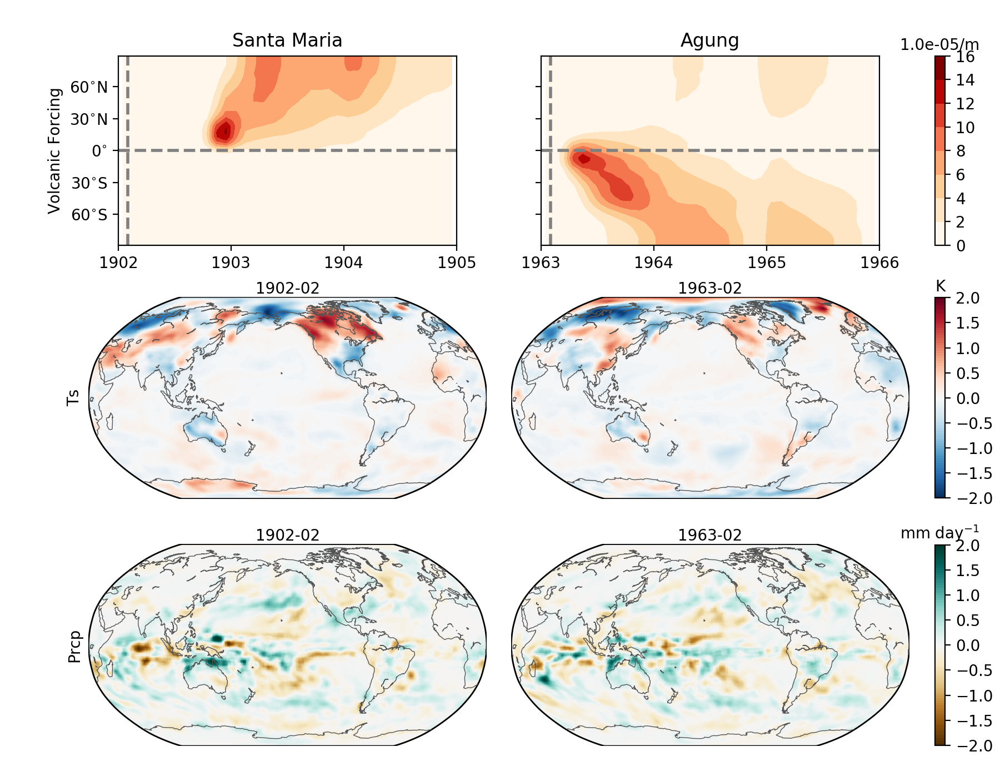

month 02; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


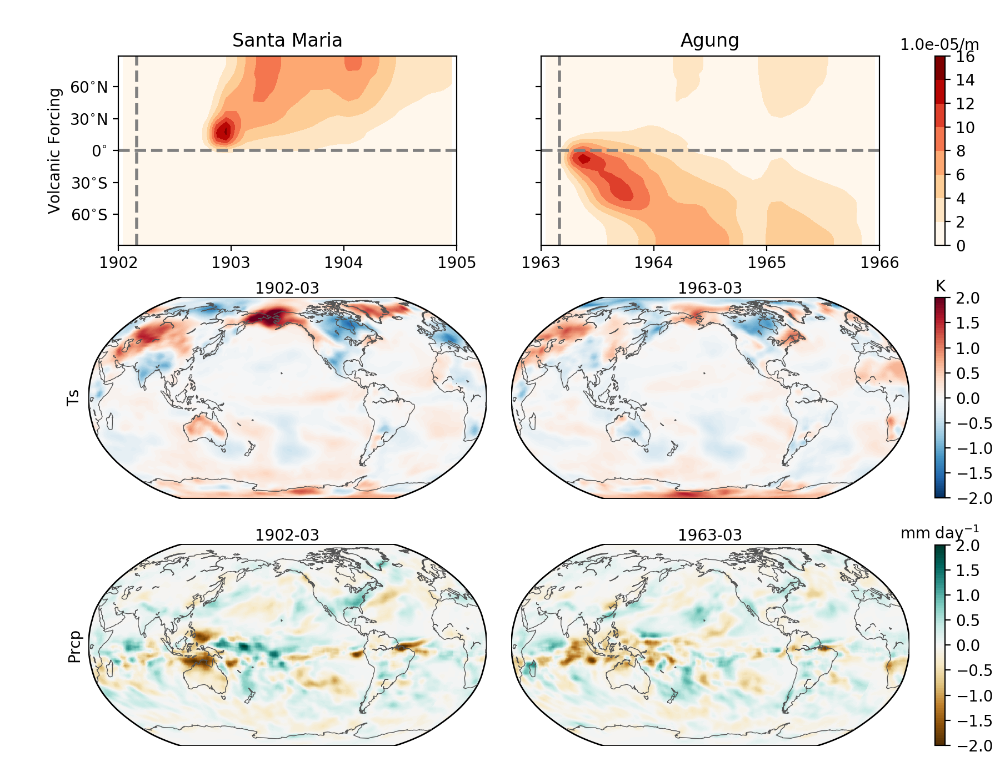

month 03; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


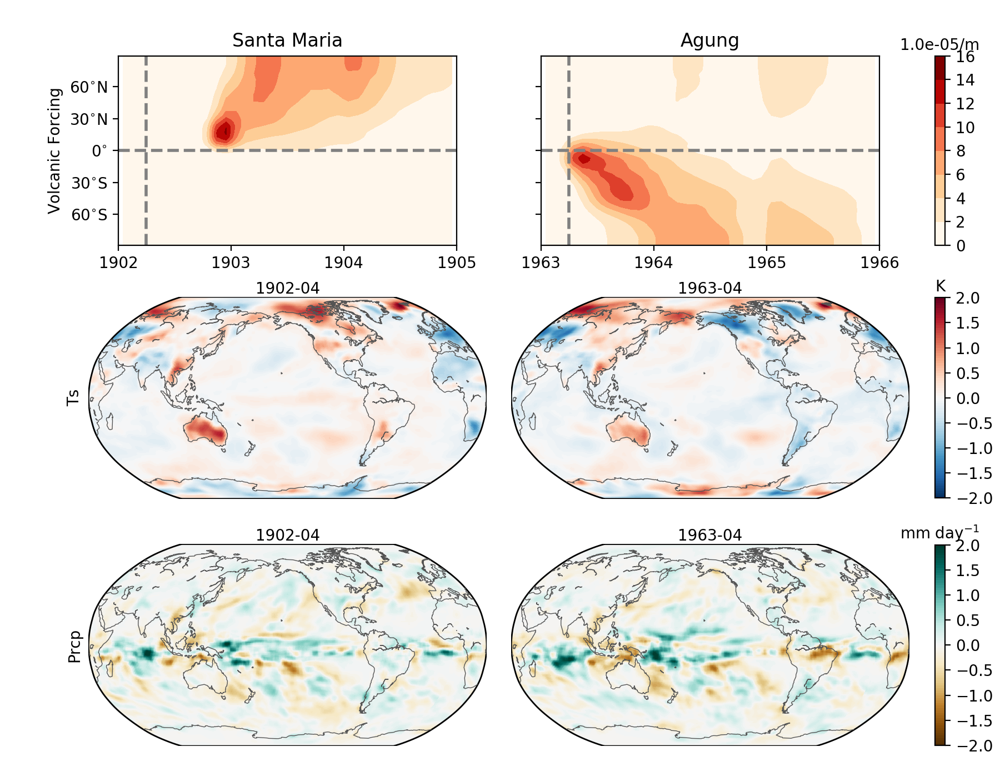

month 04; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


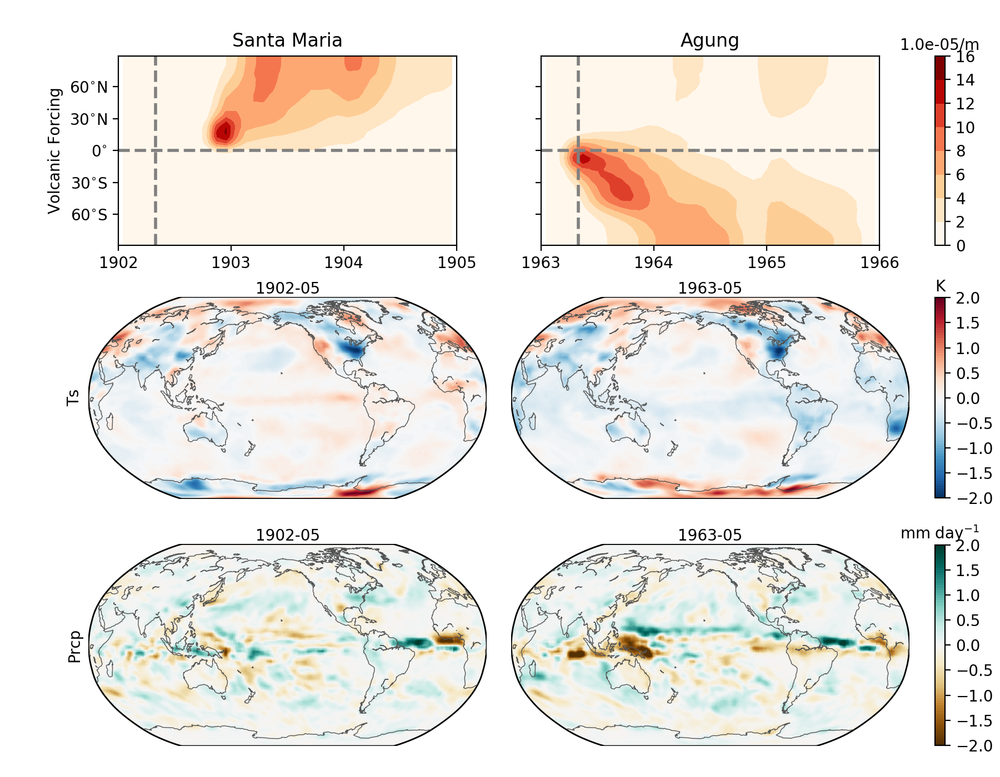

month 05; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


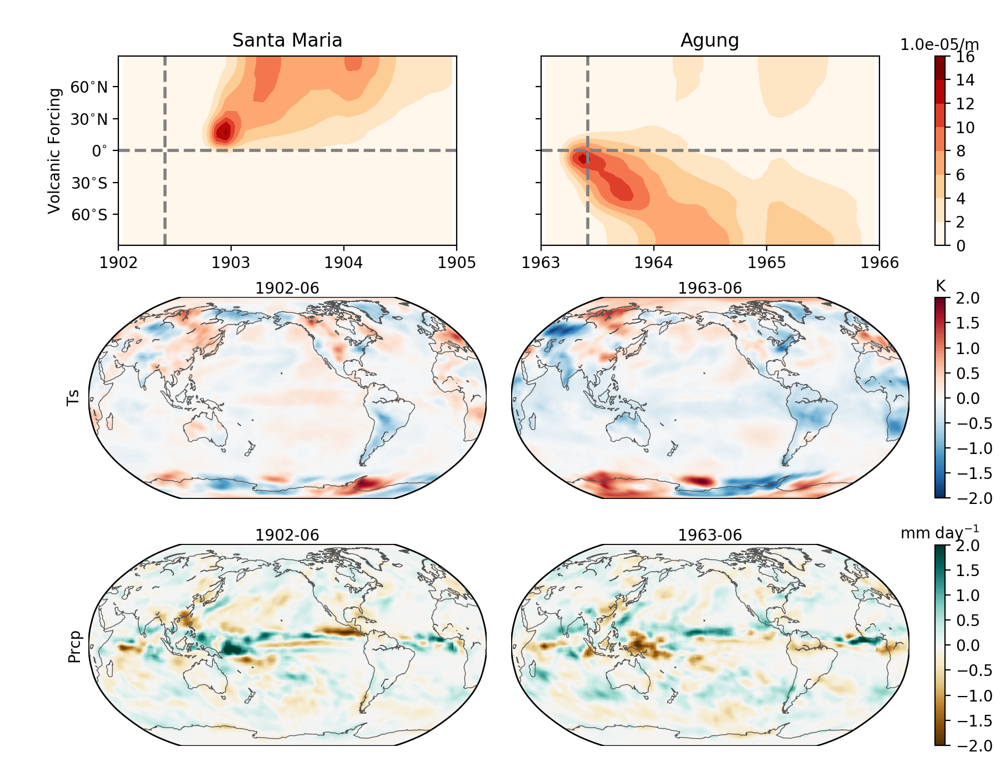

month 06; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


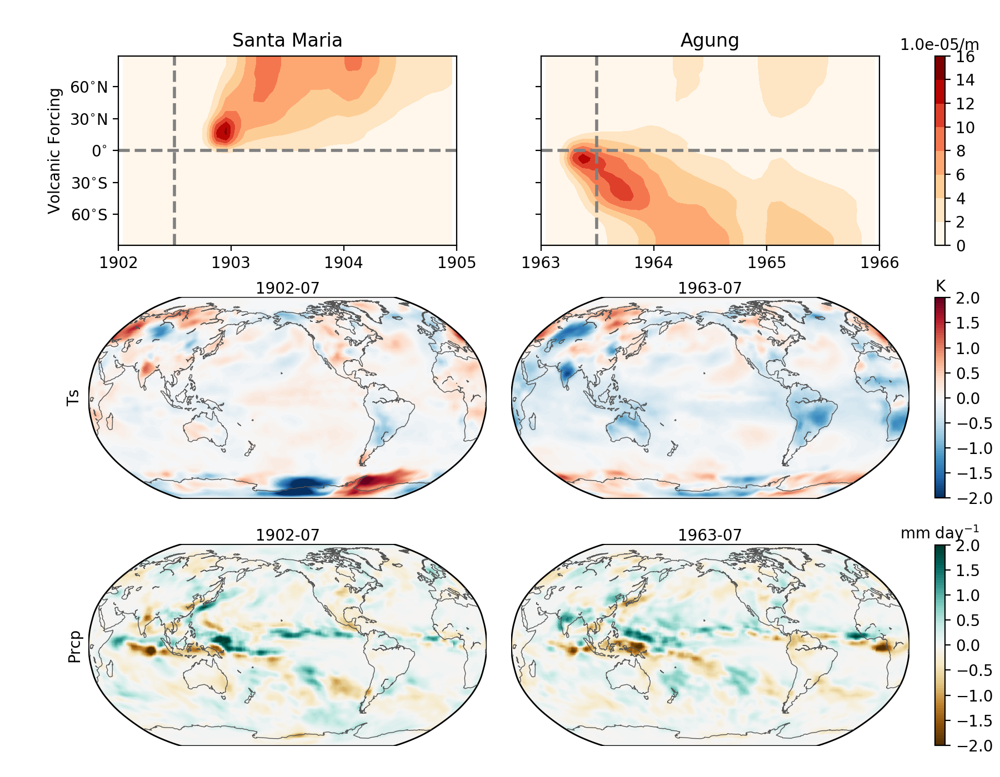

month 07; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


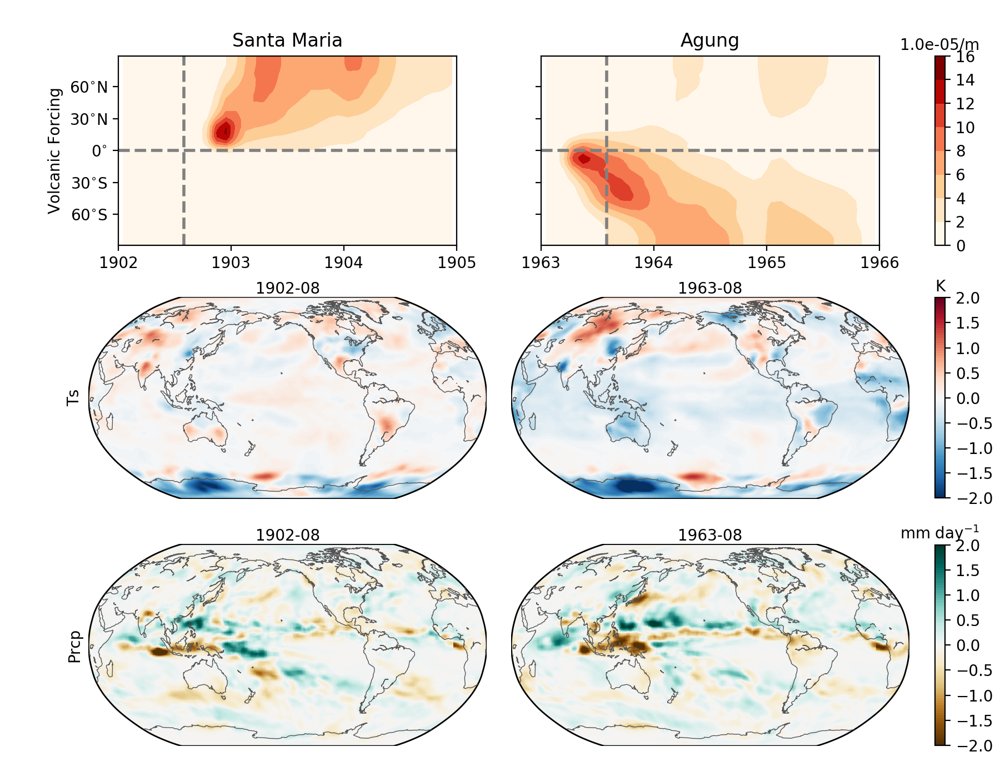

month 08; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


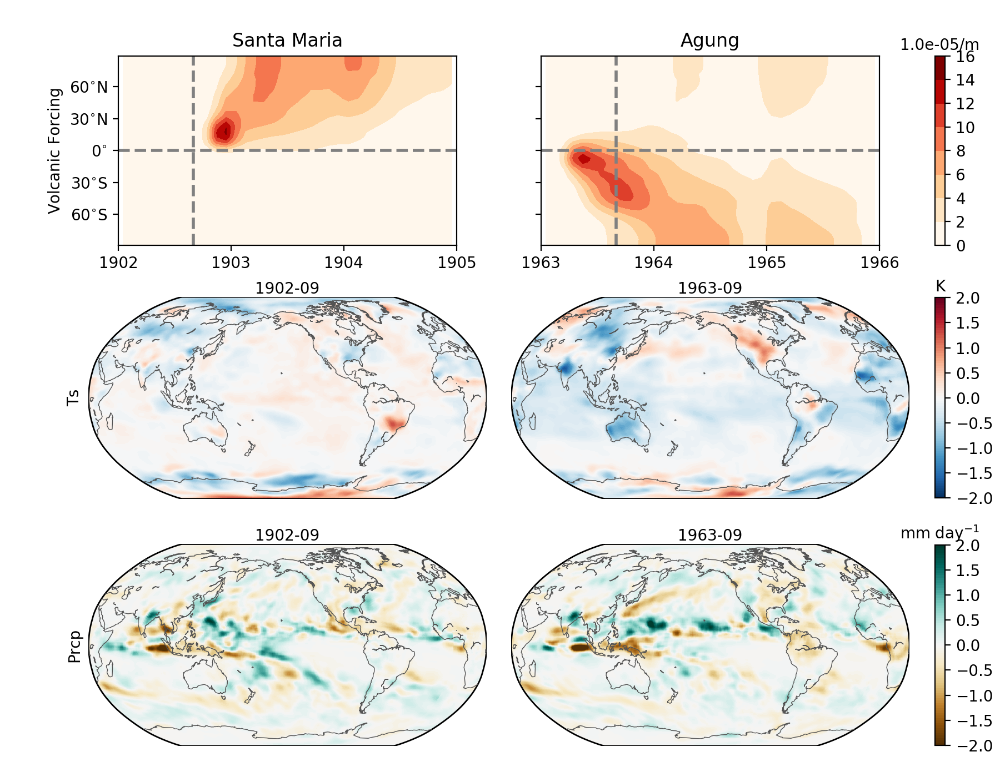

month 09; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


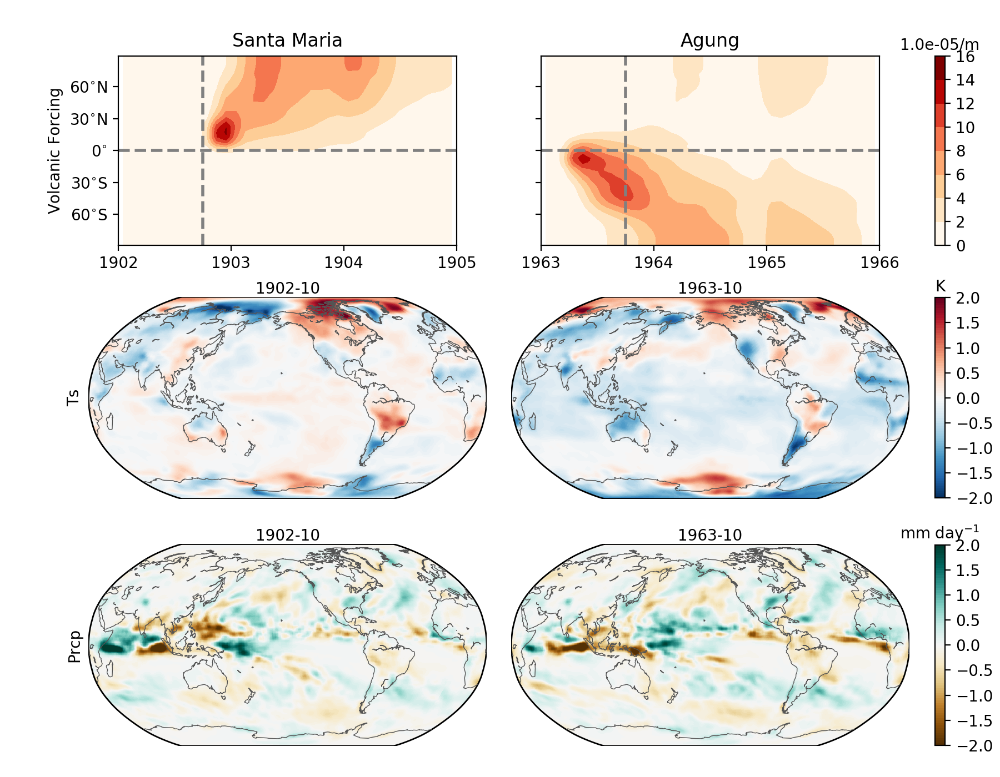

month 10; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


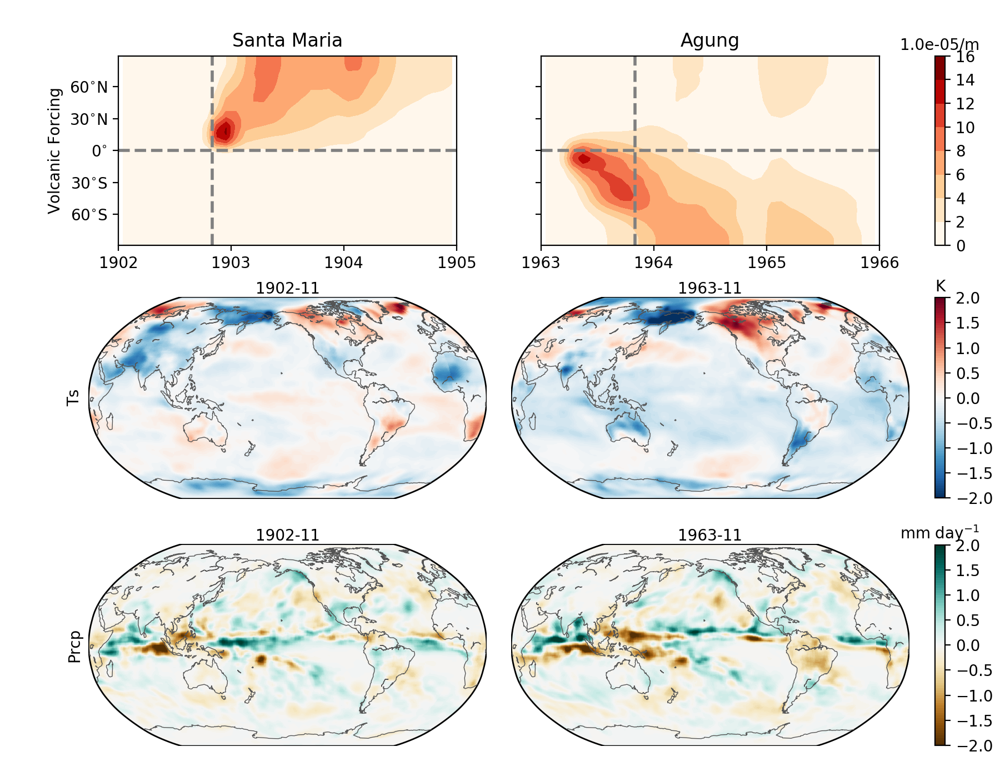

month 11; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


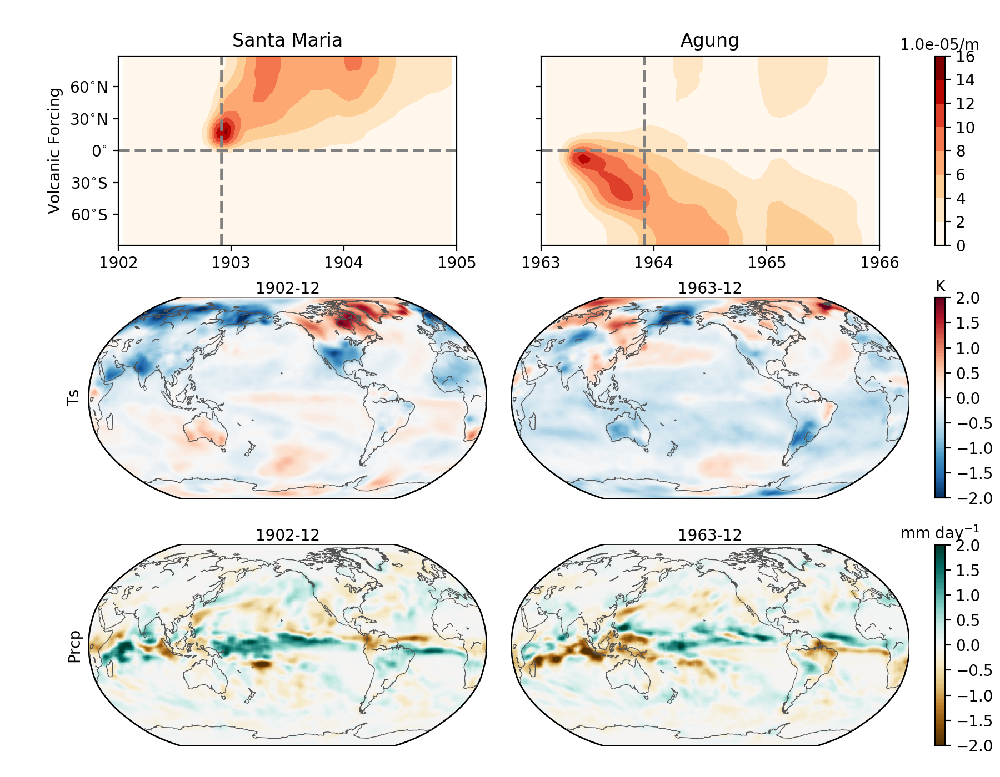

month 12; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


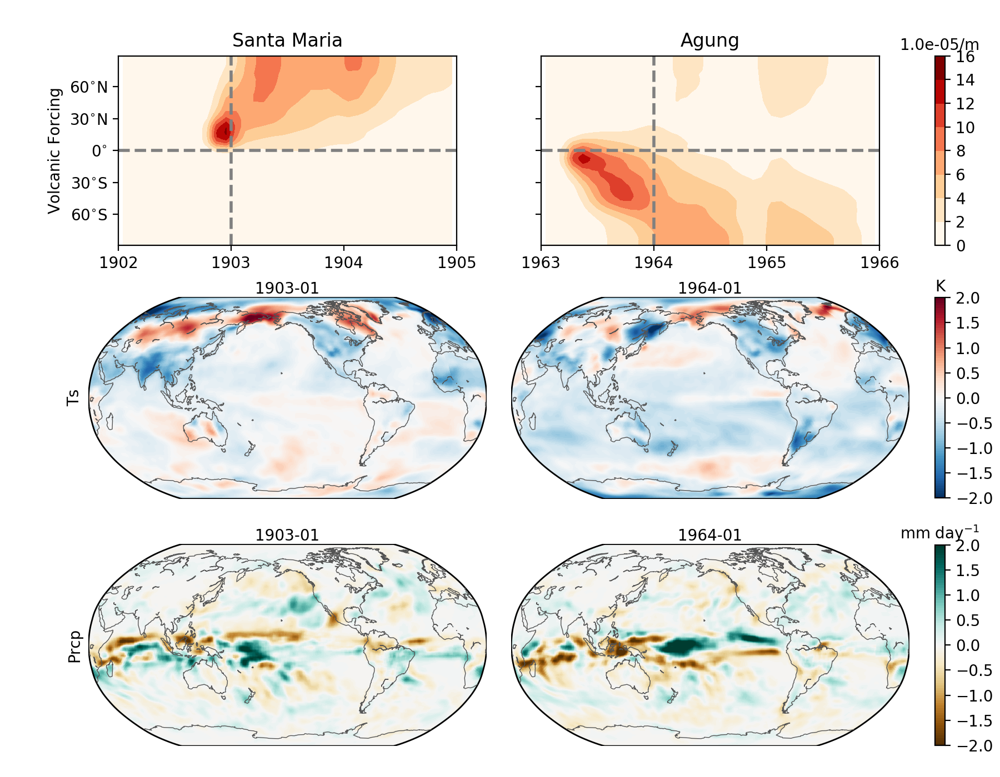

month 13; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


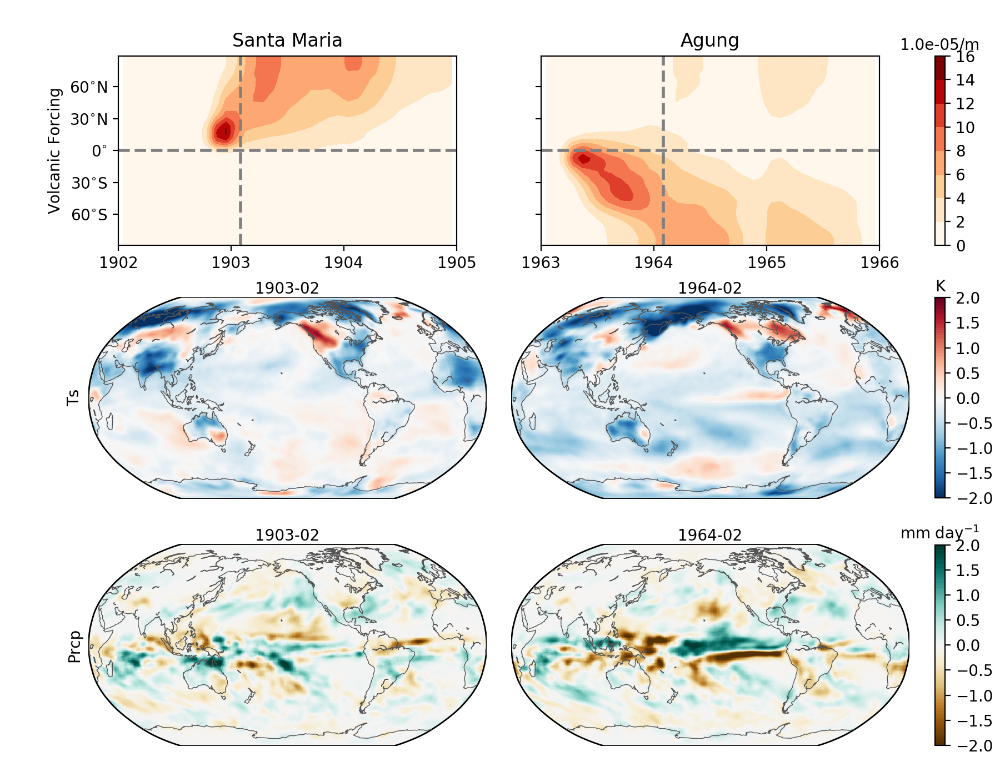

month 14; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


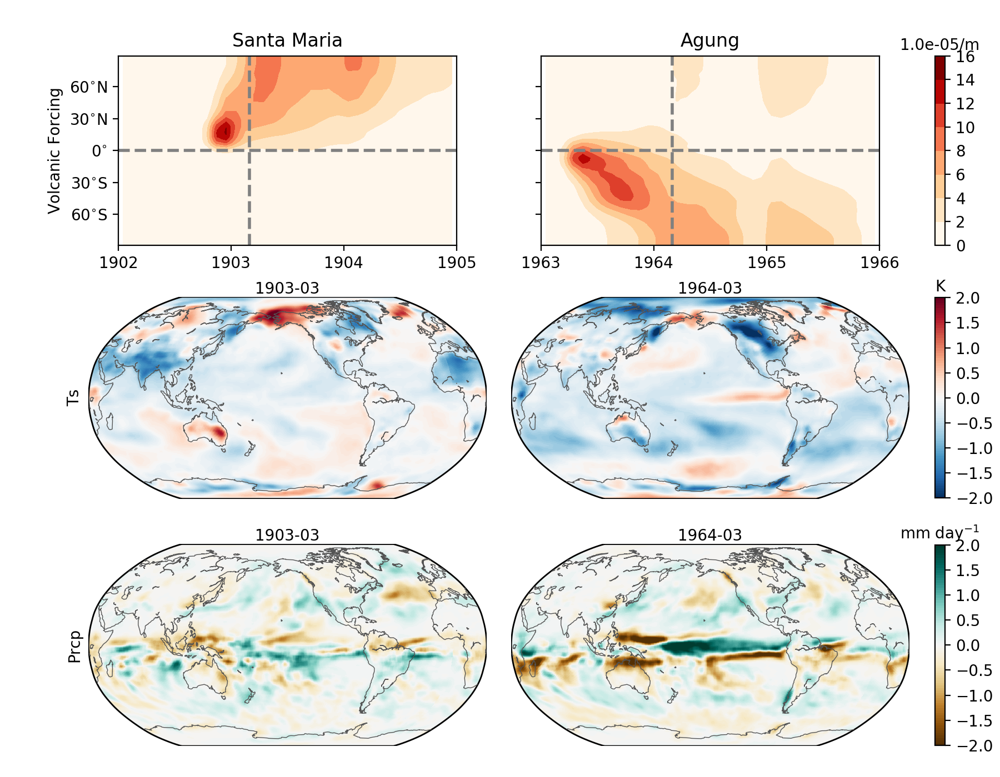

month 15; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


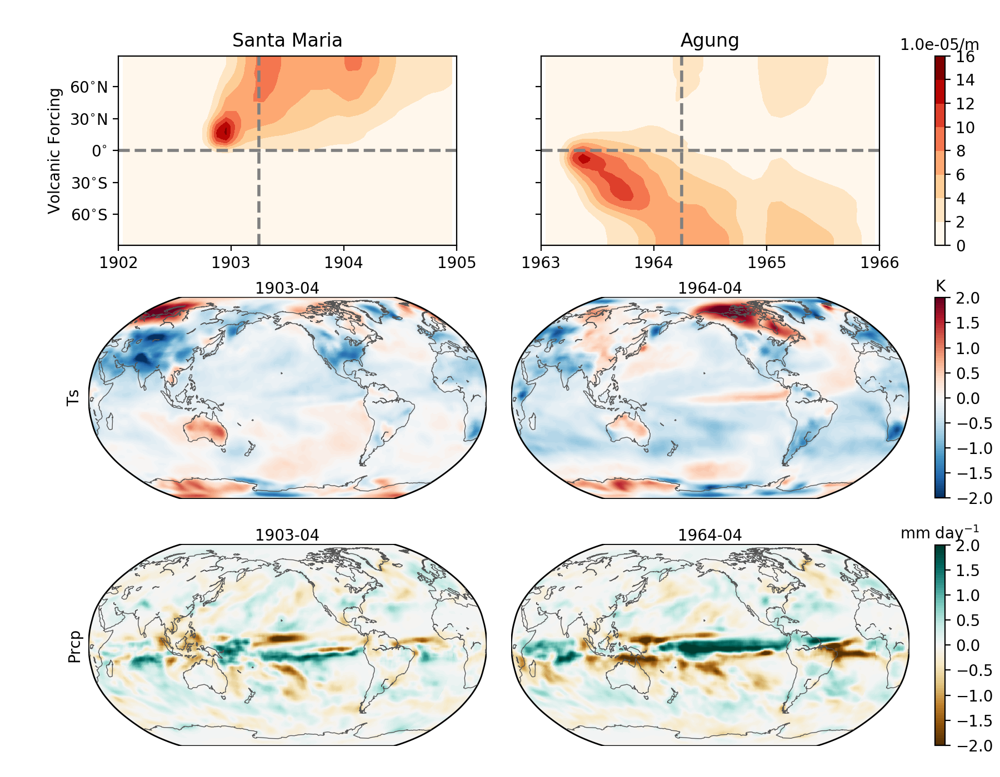

month 16; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


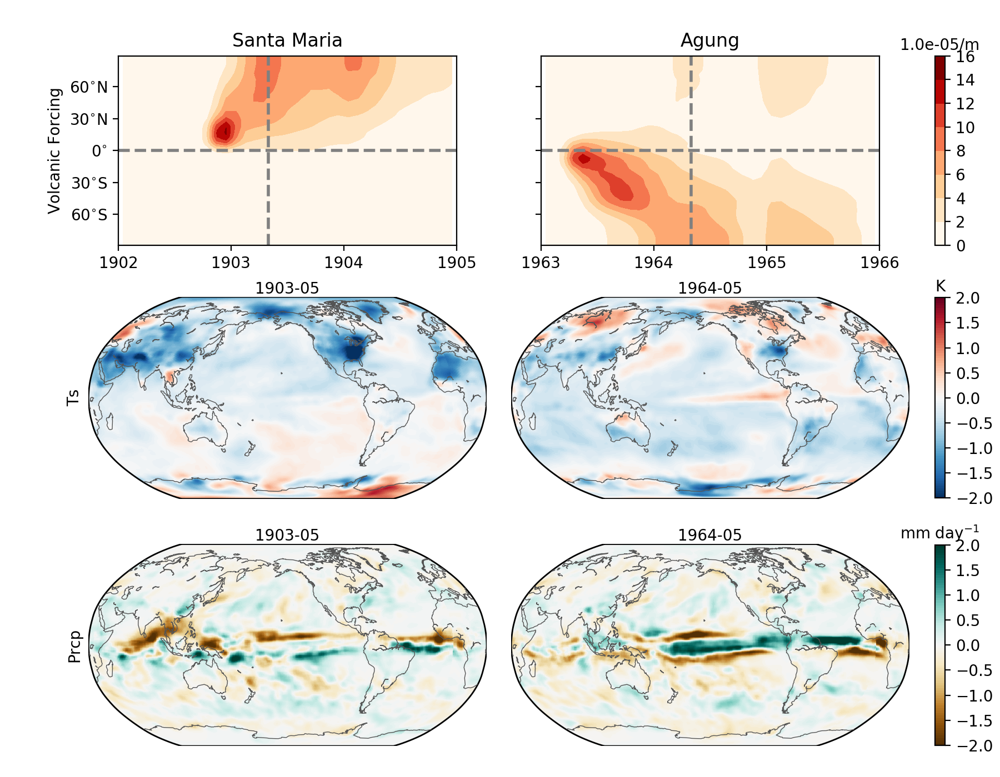

month 17; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


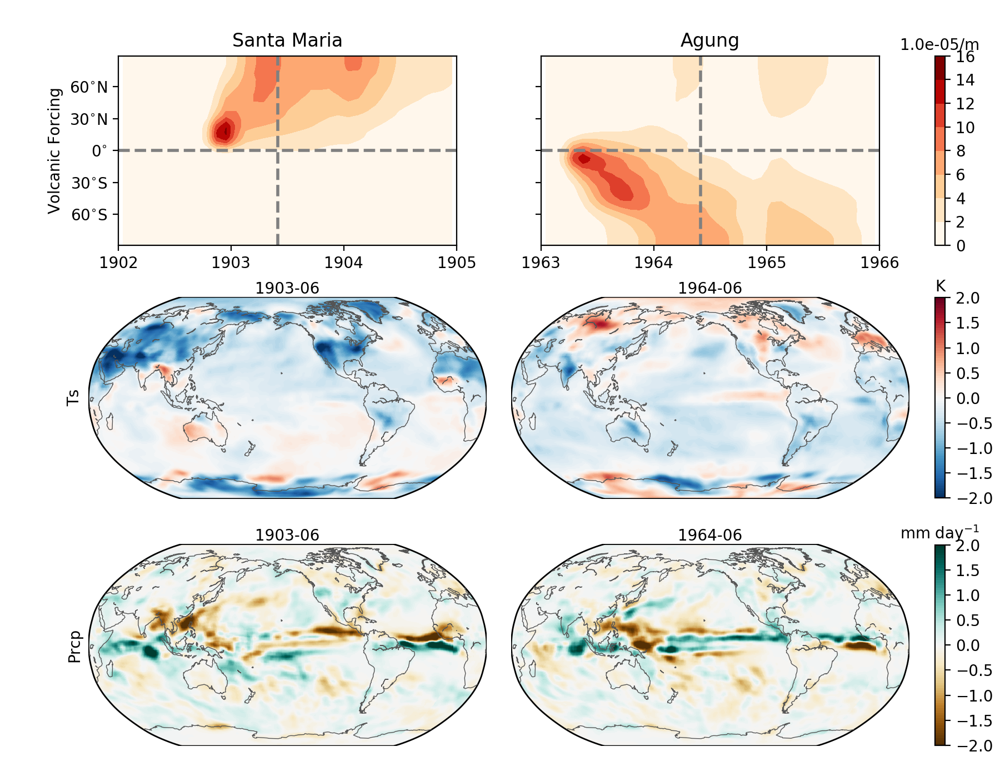

month 18; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


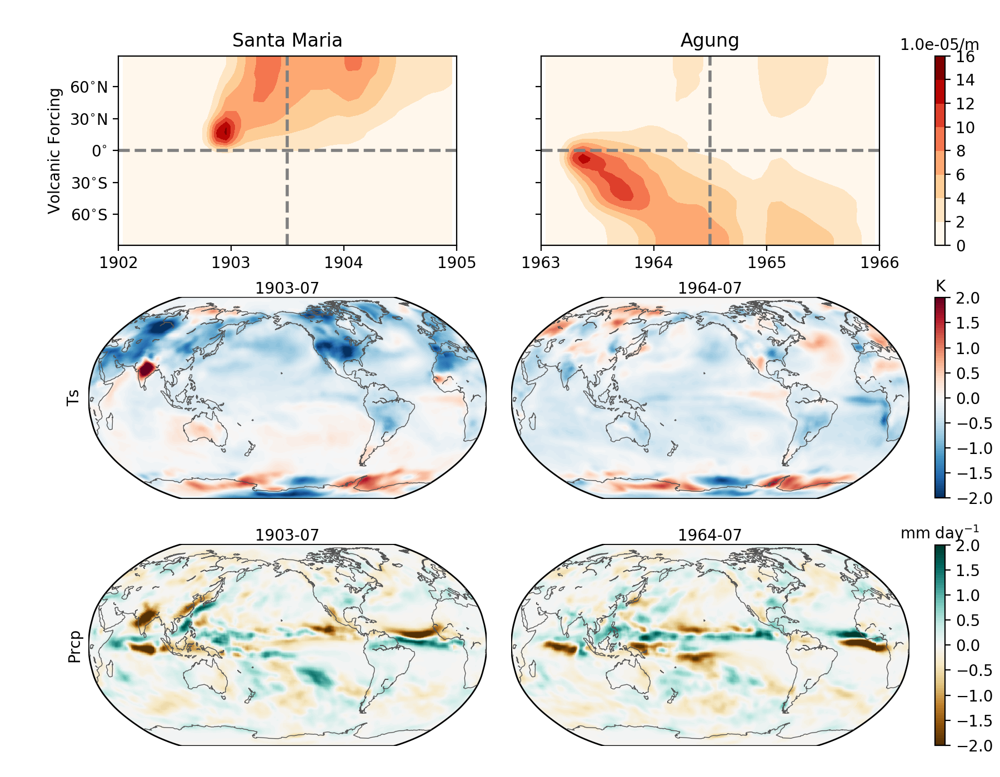

month 19; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


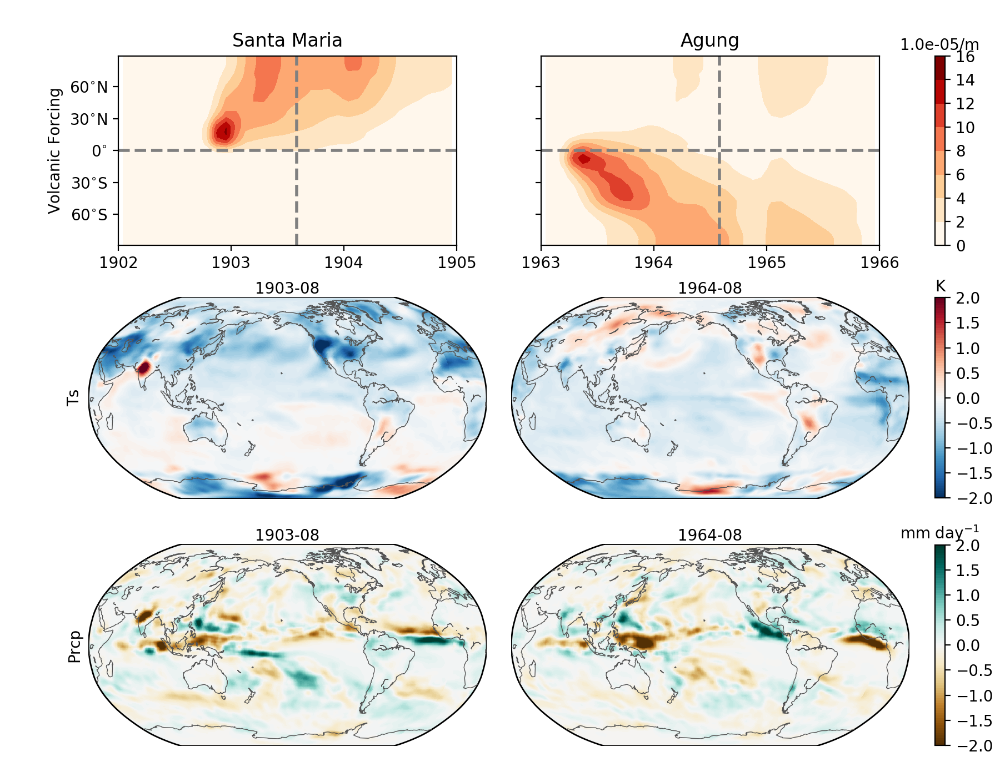

month 20; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


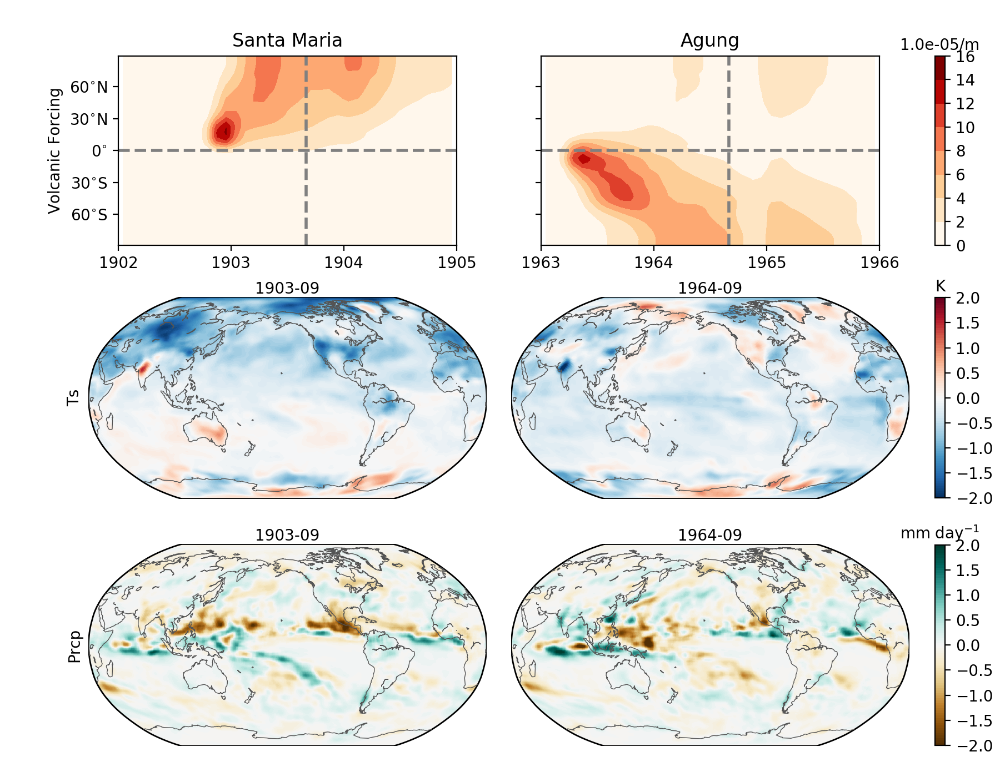

month 21; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


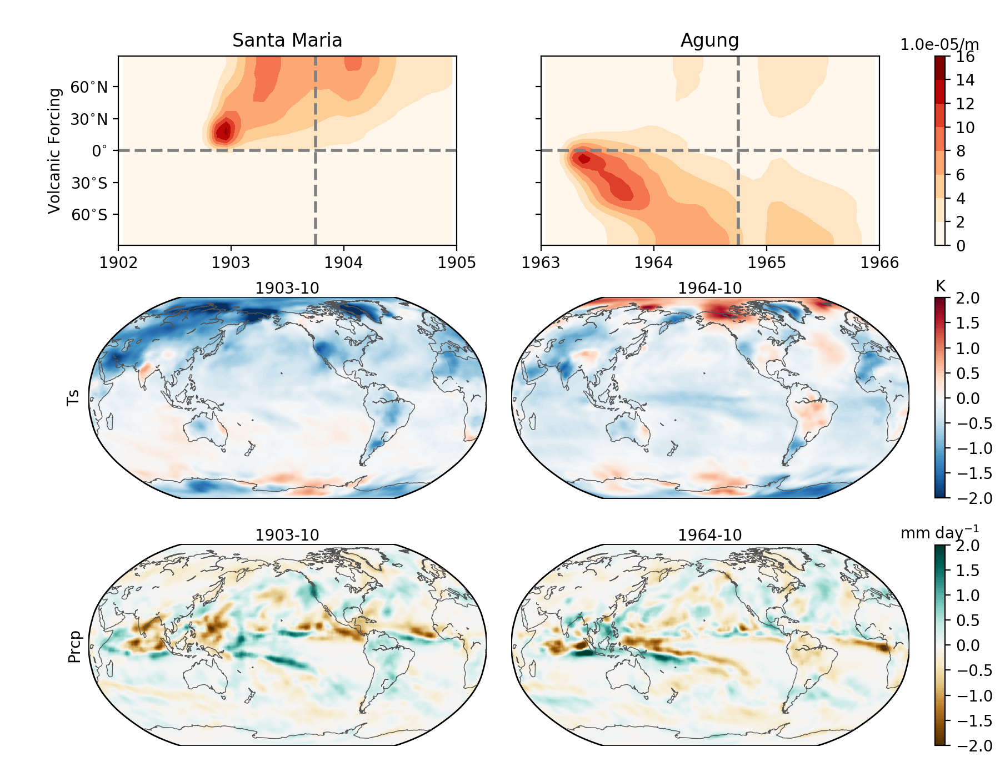

month 22; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


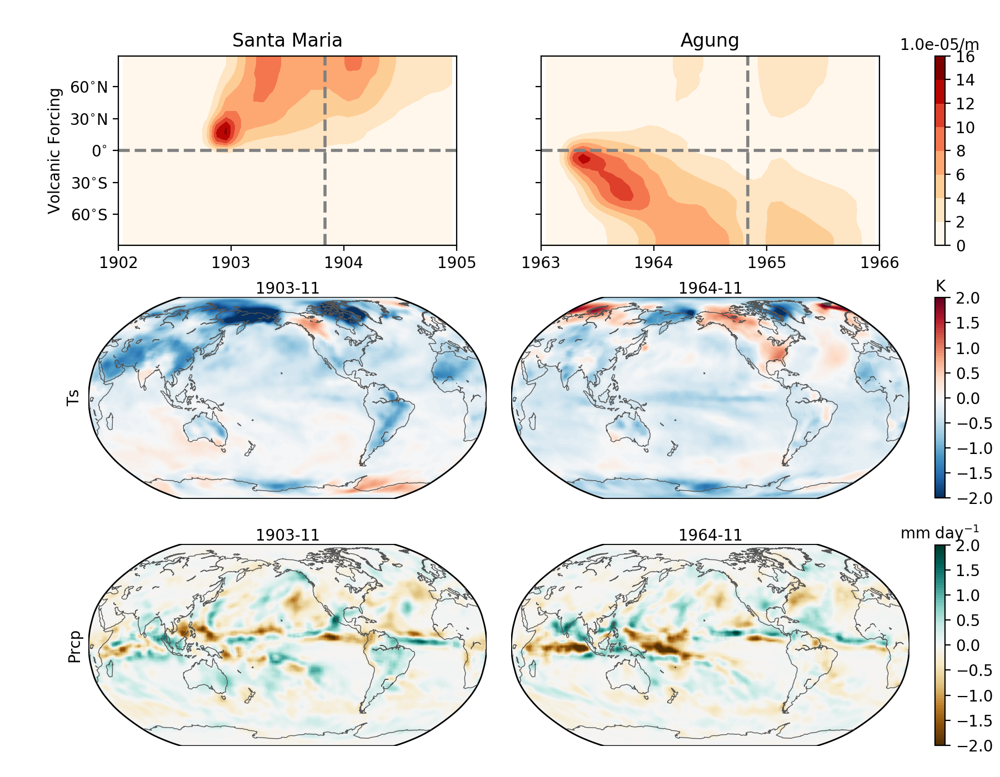

month 23; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


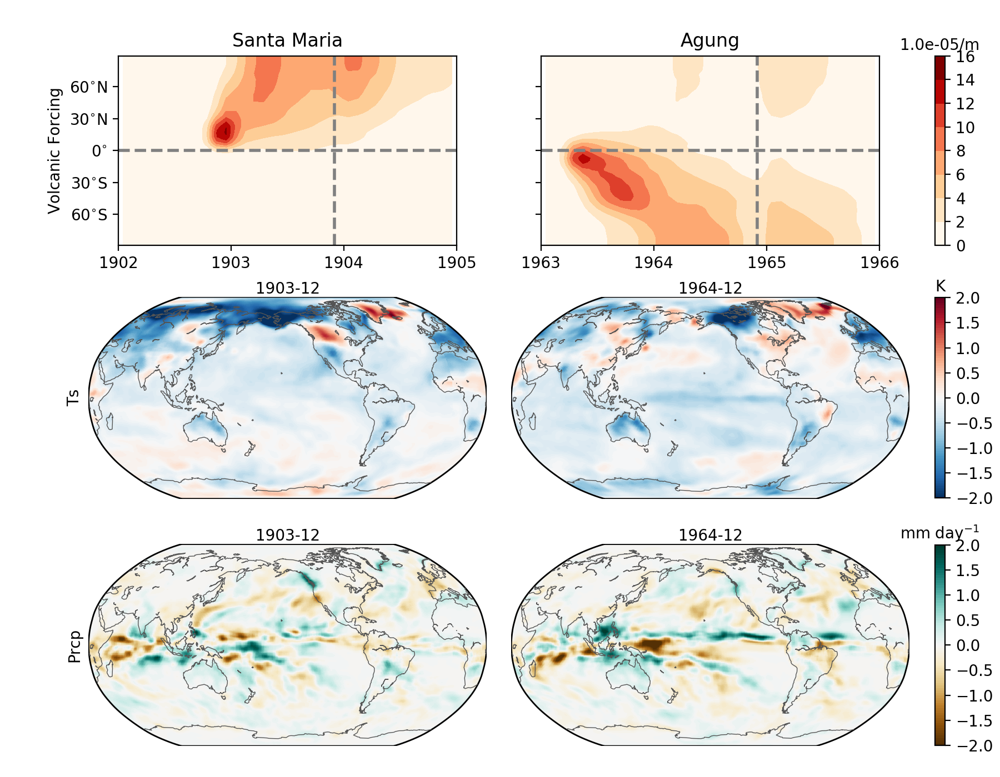

month 24; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


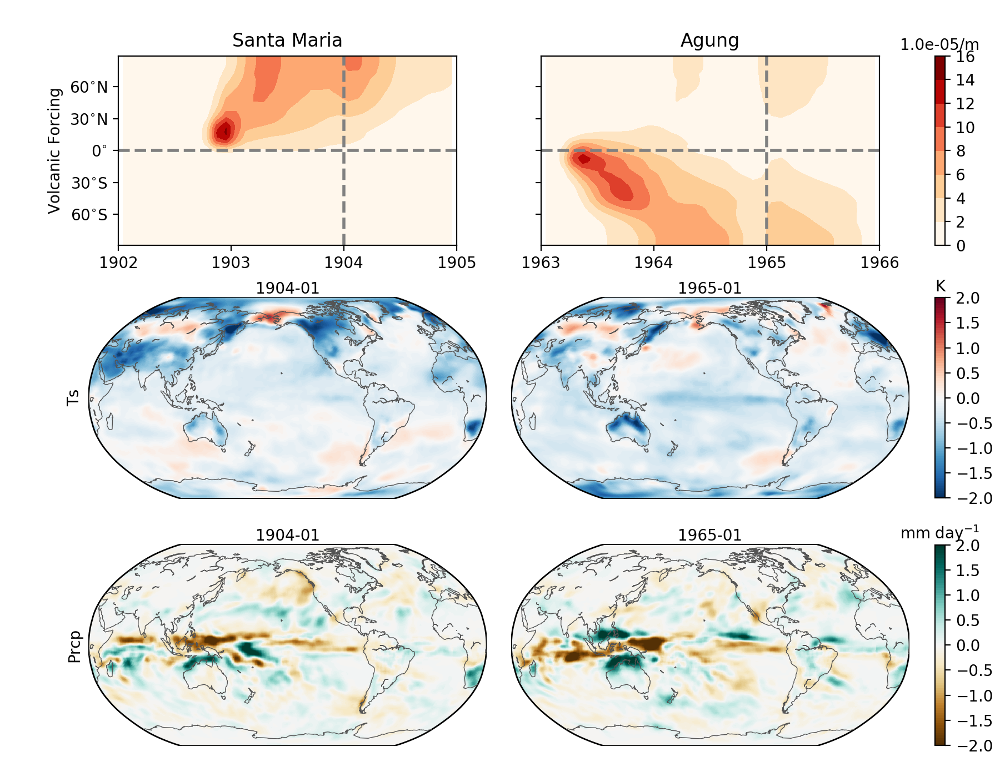

month 25; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


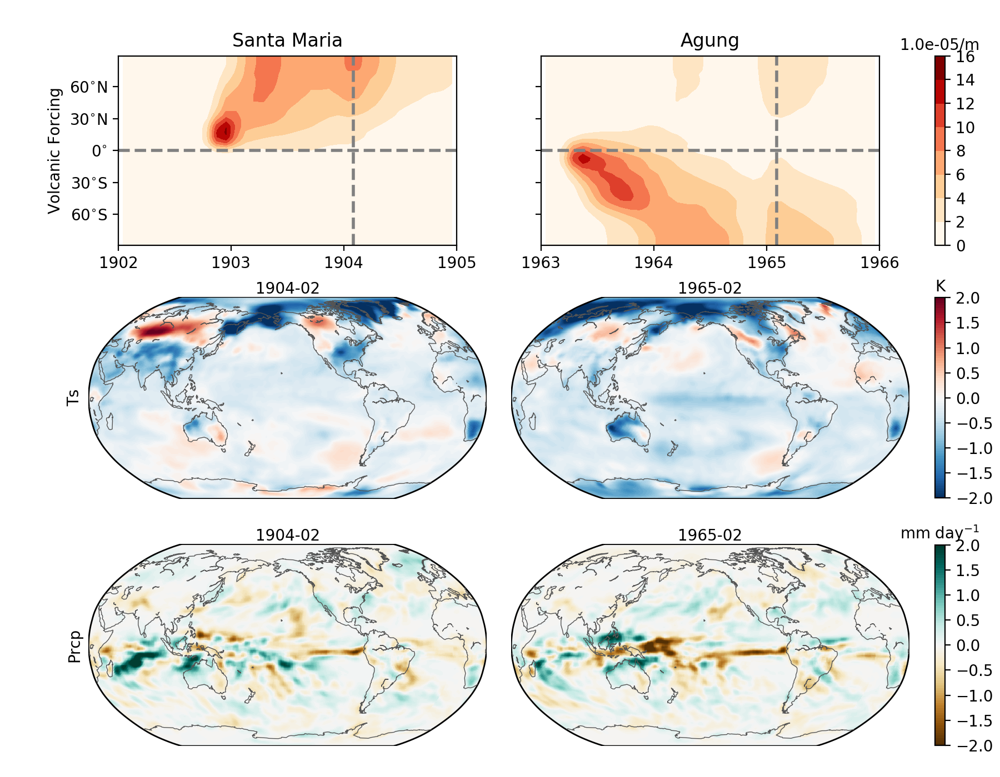

month 26; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


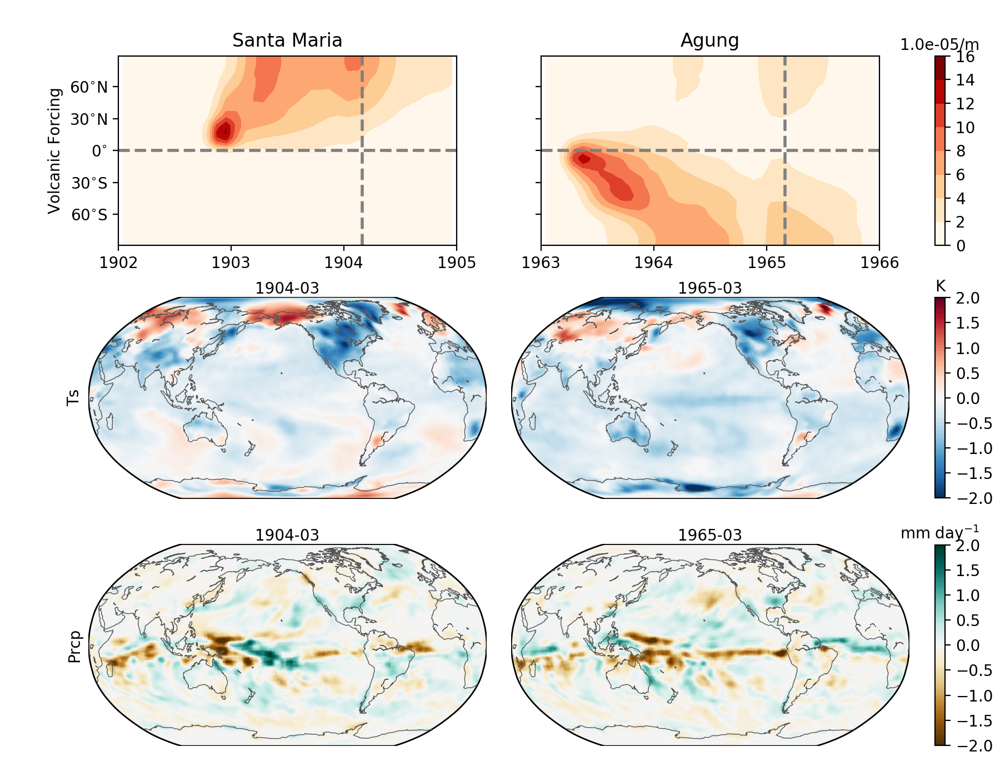

month 27; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


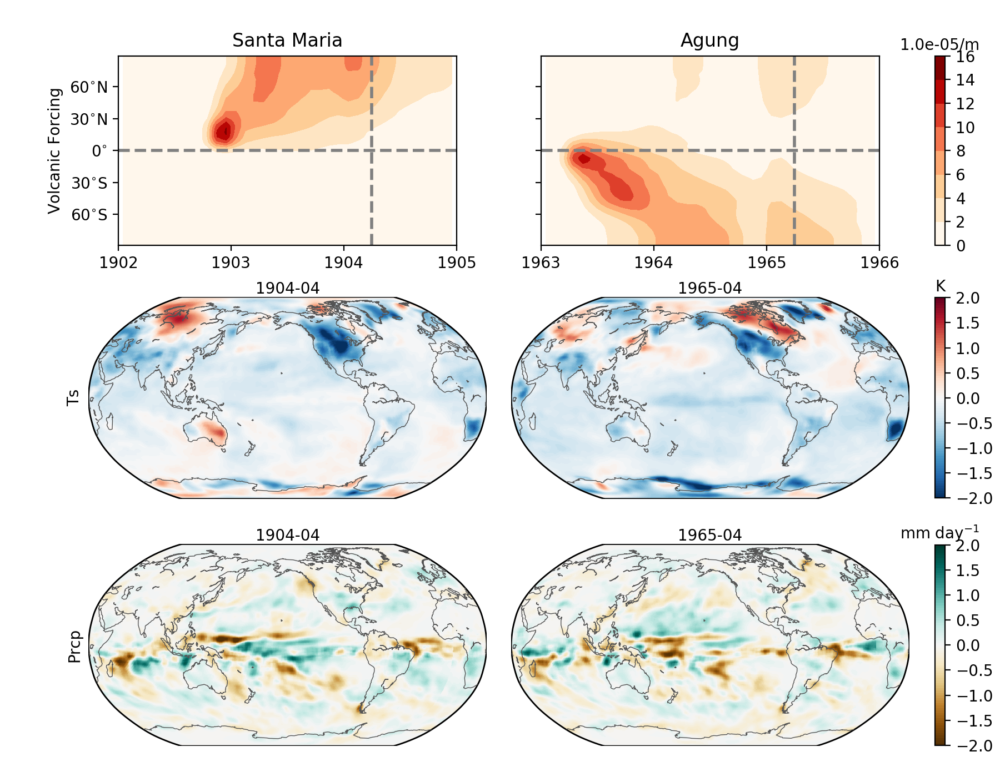

month 28; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


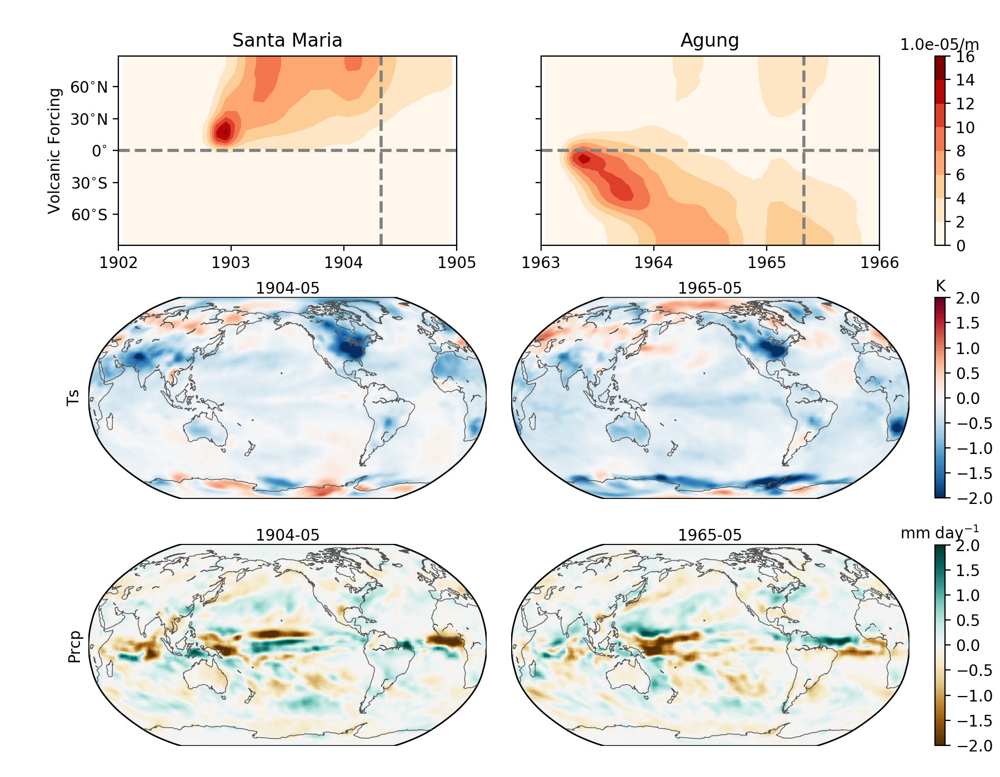

month 29; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


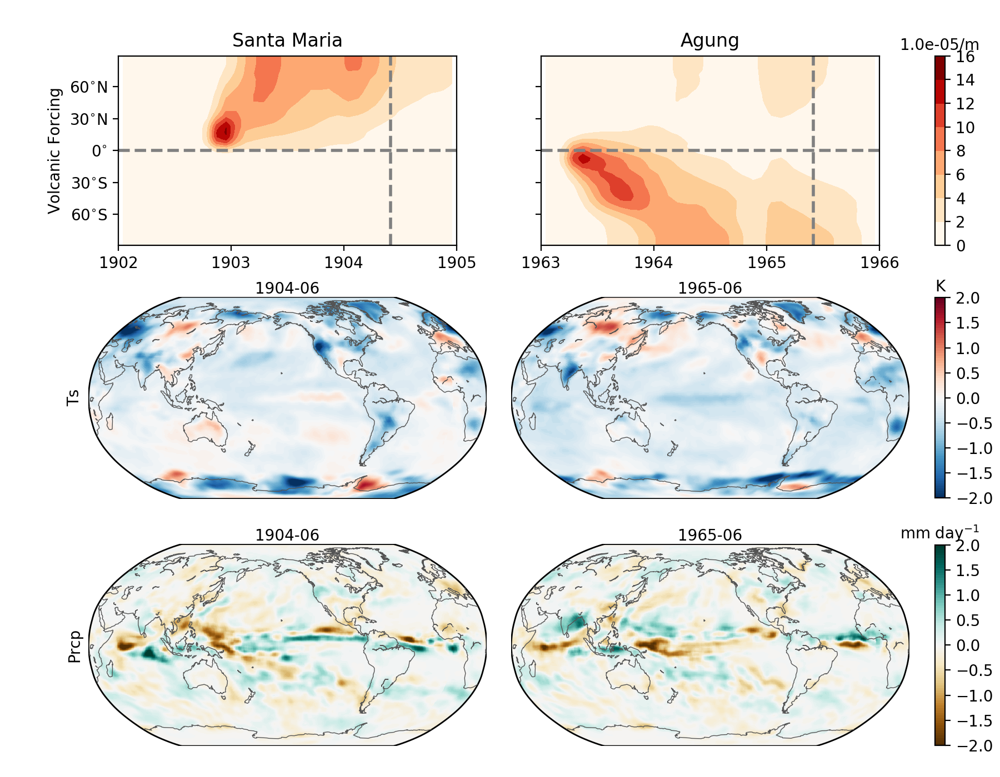

month 30; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


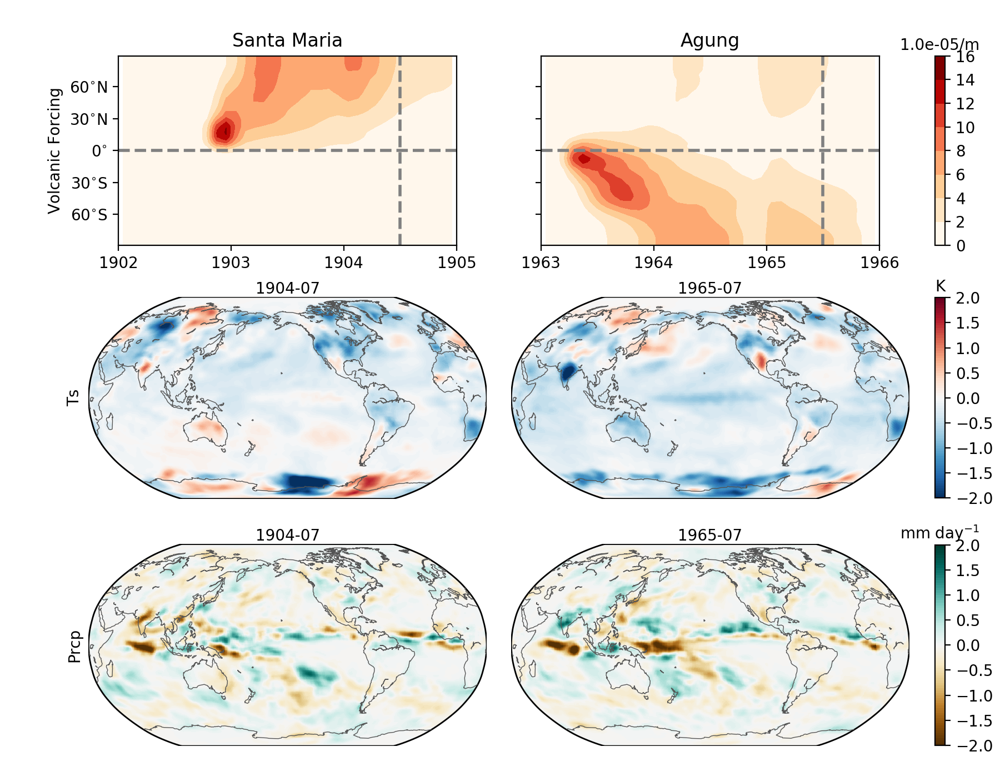

month 31; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


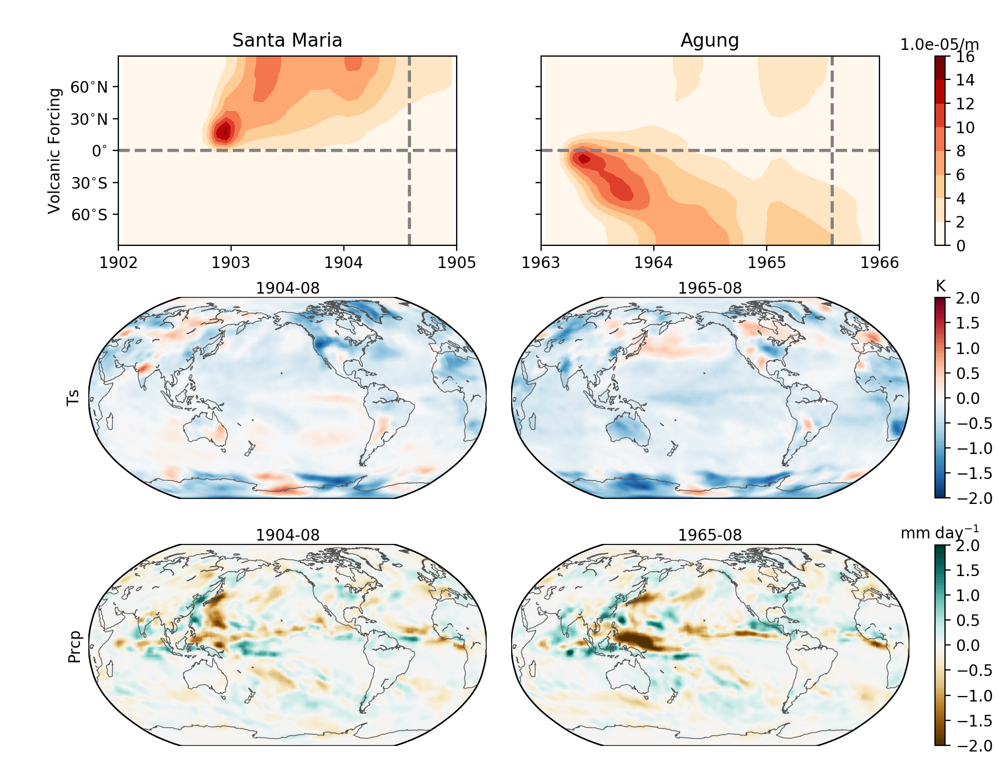

month 32; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


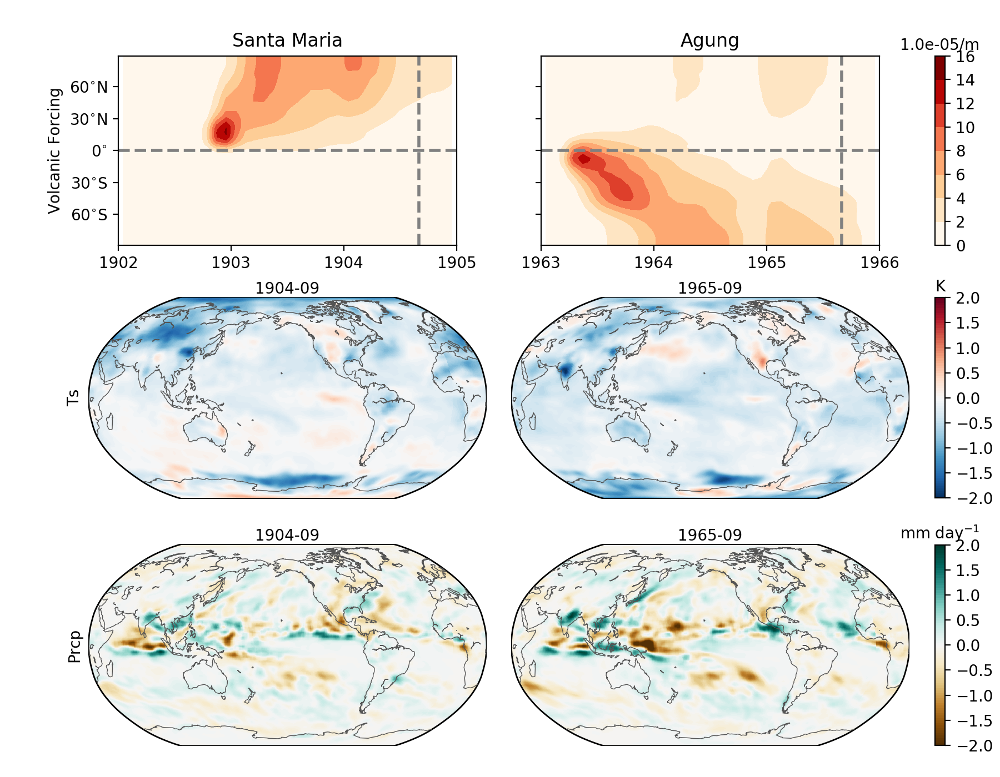

month 33; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


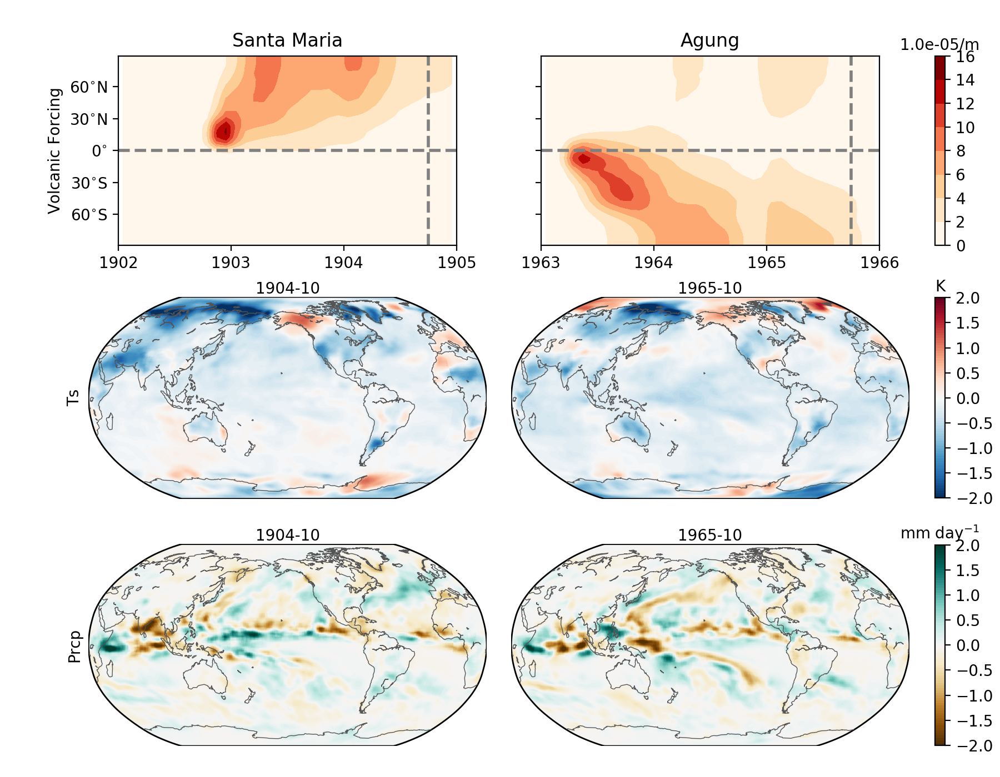

month 34; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


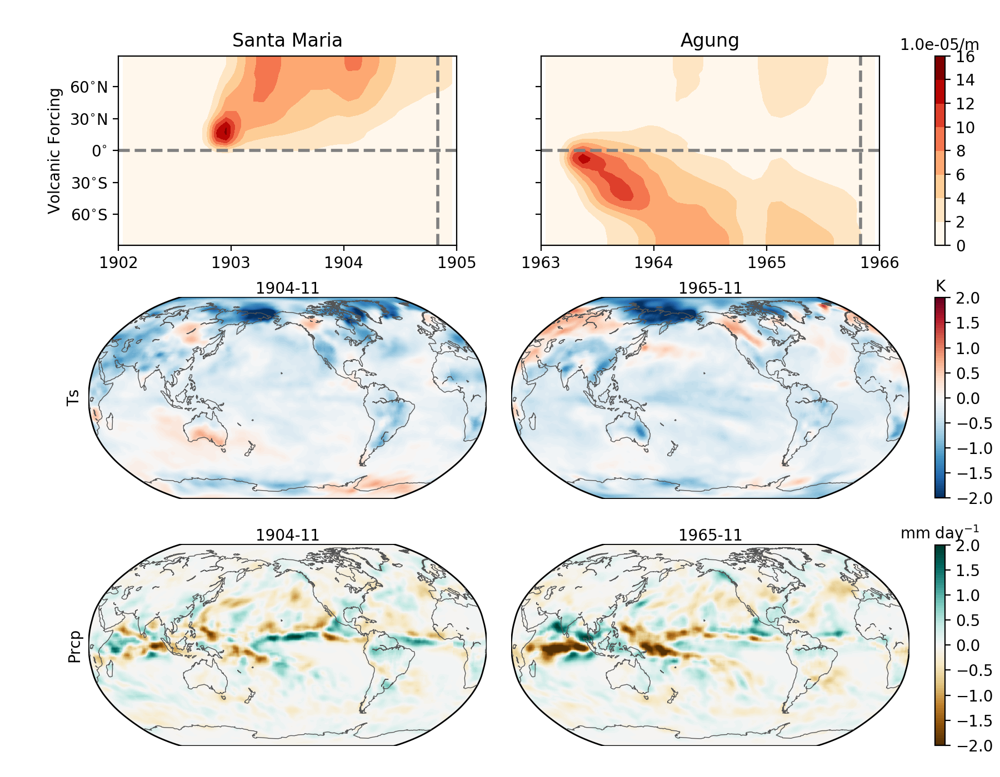

month 35; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.


<IPython.core.display.Javascript object>


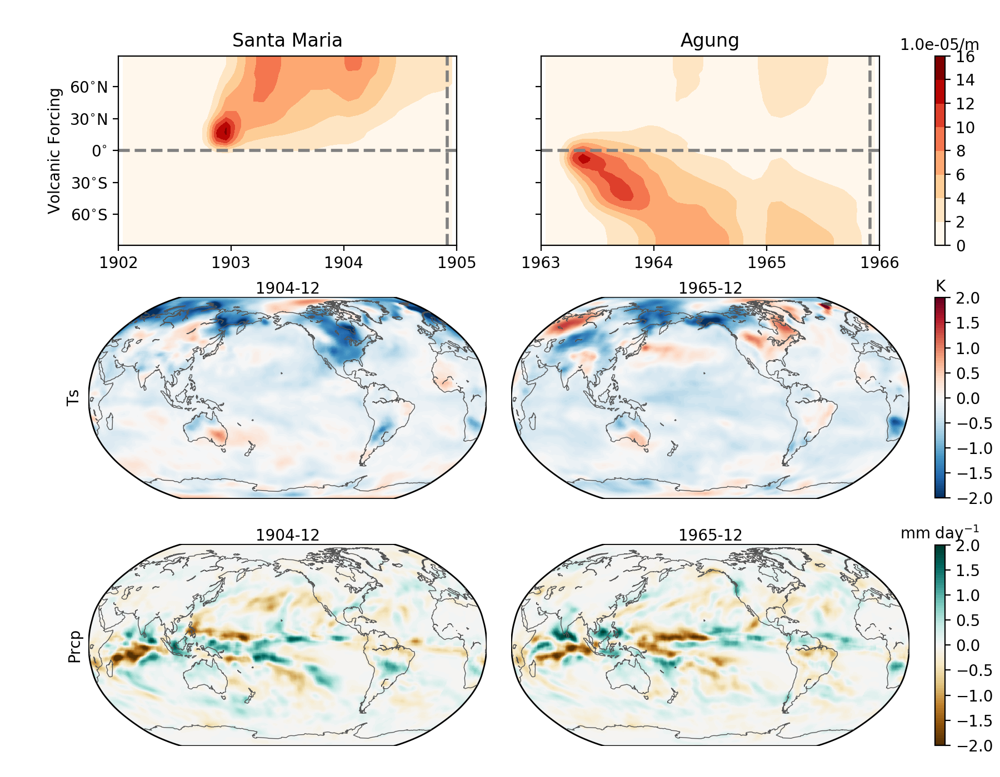

month 36; plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.
plot_type **** pcolormesh **** is used.

[OK]: convert -delay 100 -loop 0 img/frames/volc_01.jpg img/frames/volc_02.jpg img/frames/volc_03.jpg img/frames/volc_04.jpg img/frames/volc_05.jpg img/frames/volc_06.jpg img/frames/volc_07.jpg img/frames/volc_08.jpg img/frames/volc_09.jpg img/frames/volc_10.jpg img/frames/volc_11.jpg img/frames/volc_12.jpg img/frames/volc_13.jpg img/frames/volc_14.jpg img/frames/volc_15.jpg img/frames/volc_16.jpg img/frames/volc_17.jpg img/frames/volc_18.jpg img/frames/volc_19.jpg img/frames/volc_20.jpg img/frames/volc_21.jpg img/frames/volc_22.jpg img/frames/volc_23.jpg img/frames/volc_24.jpg img/frames/volc_25.jpg img/frames/volc_26.jpg img/frames/volc_27.jpg img/frames/volc_28.jpg img/frames/volc_29.jpg img/frames/volc_30.jpg img/frames/volc_31.jpg img/frames/volc_32.jpg img/frames/volc_33.jpg img/frames/volc_34.jpg img/frames/vol

In [279]:
# plot precip and t_surf
# months = [1,] + list( range(1, 37) ) 
months = range(1, 37)
scale_factor = 1e5
for imonth in months:
    fig, axes = plt.subplots(3, 2, figsize=(9,7), sharey='row')
#     fig, axes = plt.subplots(3, 2, figsize=(6,4), sharey='row')
#     if len(fig.get_axes())>6: # remove the 3 colorbars
#         for ax in fig.get_axes()[6:]:
#             ax.remove()
#     for ax in axes.flat:
#         ax.clear()
        
    yearA = 1963 + (imonth-1)//12
    monA = imonth - (imonth-1)//12*12
    yearS = 1902 + (imonth-1)//12
    monS = imonth - (imonth-1)//12*12
    print('month', f'{imonth:02d}', end='; ')

    ax = axes[0, 0]
    plt.sca(ax)
    imVolc = extsw.pipe(lambda x: x*scale_factor).sel(time=slice('1902','1904')) \
        .plot.contourf(x='time', 
                       cmap='OrRd', 
                       levels=np.arange(0,16.1,2),
                       add_colorbar=False, ax=ax)
    ax.axvline(f'{yearS}-{monS}', color='gray', ls='--')
    ax.axhline(0, color='gray', ls='--')
    ax.set_xlabel('')
    ax.set_ylabel('Volcanic Forcing')
    yticks2lat(np.arange(-90, 91, 30))
#     ax.text(0.02, 0.98, f'Santa Maria',
#             ha='left', va='top', transform=ax.transAxes)
    ax.set_title('Santa Maria')
    ax.set_xticks([f'{year}-01' for year in range(1902, 1906)])
    ax.set_xticklabels([f'{year}' for year in range(1902, 1906)])

    ax = axes[0, 1]
    plt.sca(ax)
    extsw.pipe(lambda x: x*scale_factor).sel(time=slice('1963','1965')) \
        .plot.contourf(x='time', 
                       cmap='OrRd', 
                       levels=np.arange(0,16.1,2),
                       add_colorbar=False, ax=ax)
    ax.axvline(f'{yearA}-{monA}', color='gray', ls='--')
    ax.axhline(0, color='gray', ls='--')
    ax.set_xticklabels(['0001-01', '0002-01', '0003-01'])
    ax.set_xlabel('')
    ax.set_ylabel('')
#     yticks2lat(np.arange(-90, 91, 30))
#     ax.text(0.02, 0.98, f'Agung', 
#             ha='left', va='top', transform=ax.transAxes)
    ax.set_title('Agung')
    ax.set_xticks([f'{year}-01' for year in range(1963, 1967)])
    ax.set_xticklabels([f'{year}' for year in range(1963, 1967)])

    
    ax = axes[1, 0]
    plt.sca(ax)
    ( das['t_surf_StMaria'] - das['t_surf_StMaria_ctl'] ) \
        .sel(time=f'{yearS}-{monS}').mean(['en', 'time']) \
        .pipe(lambda x: x.rolling(lon=9, center=True, min_periods=1)).mean() \
        .pipe(lambda x: x.rolling(lat=9, center=True, min_periods=1)).mean() \
        .geo.plot(proj='robin', cmap='RdBu_r', lon_0=210, 
                  ax=ax, levels=np.arange(-2,2.01,0.05), cbar_on=False, grid_on=False)
#         .plot(cmap='RdBu_r', ax=ax, add_colorbar=False, vmin=-2, vmax=2)

    plt.sca(ax)
#     mapplot()
    ax.set_xlabel('')
    ax.set_ylabel('Ts')
#     ax.set_title('Precipitation Response [mm day$^{-1}$]')
    ax.text(0.5, 1, f'{yearS}-{monS:02d}', 
            ha='center', va='bottom', transform=ax.transAxes)
    
    
    ax = axes[1, 1]
    imTas = ( das['t_surf_Agung'] - das['t_surf_Agung_ctl'] ) \
        .sel(time=f'{yearA}-{monA}').mean(['en', 'time']) \
        .pipe(lambda x: x.rolling(lon=9, center=True, min_periods=1)).mean() \
        .pipe(lambda x: x.rolling(lat=9, center=True, min_periods=1)).mean() \
        .geo.plot(proj='robin', cmap='RdBu_r', lon_0=210, 
                  ax=ax, levels=np.arange(-2,2.01,0.05), cbar_on=False, grid_on=False)
#         .plot(cmap='RdBu_r', ax=ax, add_colorbar=False, vmin=-2, vmax=2)
    plt.sca(ax)
#     mapplot()
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.text(0.5, 1, f'{yearA}-{monA:02d}', 
            ha='center', va='bottom', transform=ax.transAxes)


    ax = axes[2, 0]
    plt.sca(ax)
    ( das['precip_StMaria'] - das['precip_StMaria_ctl'] ) \
        .sel(time=f'{yearS}-{monS}').mean(['en', 'time']) \
        .pipe(lambda x: x*24*3600) \
        .pipe(lambda x: x.rolling(lon=9, center=True, min_periods=1)).mean() \
        .pipe(lambda x: x.rolling(lat=9, center=True, min_periods=1)).mean() \
        .geo.plot(proj='robin', cmap='BrBG', lon_0=210, 
                  ax=ax, levels=np.arange(-2,2.01,0.05), cbar_on=False, grid_on=False)
#         .plot(cmap='BrBG', ax=ax, add_colorbar=False, vmin=-2, vmax=2)
    plt.sca(ax)
#     mapplot()
    ax.set_xlabel('')
    ax.set_ylabel('Prcp')
#     ax.set_title('Precipitation Response [mm day$^{-1}$]')
    ax.text(0.5, 1, f'{yearS}-{monS:02d}', 
            ha='center', va='bottom', transform=ax.transAxes)


    ax = axes[2, 1]
    imPrcp = ( das['precip_Agung'] - das['precip_Agung_ctl'] ) \
        .sel(time=f'{yearA}-{monA}').mean(['en', 'time']) \
        .pipe(lambda x: x*24*3600) \
        .pipe(lambda x: x.rolling(lon=9, center=True, min_periods=1)).mean() \
        .pipe(lambda x: x.rolling(lat=9, center=True, min_periods=1)).mean() \
        .geo.plot(proj='robin', cmap='BrBG', lon_0=210, 
                  ax=ax, levels=np.arange(-2,2.01,0.05), cbar_on=False, grid_on=False)
#         .plot(cmap='BrBG', ax=ax, add_colorbar=False, vmin=-2, vmax=2)
    plt.sca(ax)
#     mapplot()
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.text(0.5, 1, f'{yearA}-{monA:02d}', 
            ha='center', va='bottom', transform=ax.transAxes)
    
    
    
    
    plt.tight_layout(rect=[0,0,0.93,1])
    # shrink axes[0,0] and axes[0,1]
    a = 0.85
    b = axes[0,0].get_position()
    xmin, xmax, ymin, ymax = b.xmin, b.xmax, b.ymin, b.ymax
    axes[0,0].set_position([xmin+(xmax-xmin)*(1-a)/2, ymin+ (ymax-ymin)*(1-a)/2, (xmax-xmin)*a, (ymax-ymin)*a])
    b = axes[0,1].get_position()
    xmin, xmax, ymin, ymax = b.xmin, b.xmax, b.ymin, b.ymax
    axes[0,1].set_position([xmin+(xmax-xmin)*(1-a)/2, ymin+ (ymax-ymin)*(1-a)/2, (xmax-xmin)*a, (ymax-ymin)*a])
    
    # show xticklabels
    plt.setp(axes[0,0].get_xticklabels(), visible=True)
    plt.setp(axes[0,1].get_xticklabels(), visible=True)
    
    # colorbars
    b = axes[0,1].get_position()
    ycenter, yheight = (b.ymax + b.ymin)/2, b.height
    figcolorbar(imVolc, center=(0.94, ycenter), height=yheight, units=f'{1/scale_factor:.1e}/m')
    b = axes[1,1].get_position()
    ycenter, yheight = (b.ymax + b.ymin)/2, b.height
    figcolorbar(imTas, center=(0.94, ycenter), height=yheight*0.9, units='K')
    b = axes[2,1].get_position()
    ycenter, yheight = (b.ymax + b.ymin)/2, b.height
    figcolorbar(imPrcp, center=(0.94, ycenter), height=yheight*0.9, units='mm day$^{-1}$')
    
    plt.savefig(f'img/frames/volc_{imonth:02d}.jpg', dpi=100)
    
    
print()
make_gif(ifile='img/frames/volc_??.jpg', ofile='img/volc_impact.gif', delay=100)
# compress the generated gif picture
# !convert volc_impact.gif -fuzz 10% -layers Optimize volc_impact_f10.gif

In [8]:
%%html
<script src="https://cdn.rawgit.com/parente/4c3e6936d0d7a46fd071/raw/65b816fb9bdd3c28b4ddf3af602bfd6015486383/code_toggle.js">
</script>